In [2]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import os
import cv2
from PIL import Image
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
%matplotlib inline

In [3]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
import torch.nn.functional as F

import torch
import torch.nn as nn
from torch.autograd import Variable

# Data Loading

In [4]:
import os
import numpy as np
import matplotlib.pyplot as plt
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
from skimage.filters import sobel
from skimage.feature import canny
import torch

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
torch.cuda.empty_cache()
# Define a custom transform to apply the same transformations to both images and masks
class JointTransform:
    def __init__(self, image_transform, mask_transform):
        self.image_transform = image_transform
        self.mask_transform = mask_transform

    def __call__(self, image, mask):
        seed = np.random.randint(2147483647)  # Random seed
        torch.manual_seed(seed)
        if self.image_transform:
            image = self.image_transform(image)
        torch.manual_seed(seed)
        if self.mask_transform:
            mask = self.mask_transform(mask)
        return image, mask

# Define image and mask transforms
image_transform = transforms.Compose([
    transforms.RandomHorizontalFlip(),
    transforms.RandomVerticalFlip(),
    transforms.RandomRotation(30),
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),
    #transforms.RandomResizedCrop(256, scale=(0.8, 1.0)),  # Added RandomResizedCrop
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
    #transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

mask_transform = transforms.Compose([
    transforms.RandomHorizontalFlip(),
    transforms.RandomVerticalFlip(),
    transforms.RandomRotation(30),
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
])

joint_transform = JointTransform(image_transform=image_transform, mask_transform=mask_transform)

def convert_to_edge_map(segmentation, method='sobel'):
    # Normalize segmentation mask
    segmentation = segmentation.astype(np.float32)
    segmentation = (segmentation - segmentation.min()) / (segmentation.max() - segmentation.min())
    
    if method == 'sobel':
        edge_map = sobel(segmentation)
    elif method == 'canny':
        edge_map = canny(segmentation)
    return edge_map

def get_image_paths(directory, extensions=['.jpg', '.jpeg', '.png', '.bmp', '.tiff']):
    image_paths = []
    # List all files in the specified directory
    for file in os.listdir(directory):
        if any(file.lower().endswith(ext) for ext in extensions):
            image_paths.append(os.path.join(directory, file))
    new_arr = sorted(image_paths)
    return new_arr

class SegmentationDataset(Dataset):
    def __init__(self, image_paths, mask_paths, transform=None):
        self.image_paths = image_paths
        self.mask_paths = mask_paths
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image = Image.open(self.image_paths[idx]).convert("RGB")
        mask = Image.open(self.mask_paths[idx]).convert("L")  # Load mask as grayscale image
        mask = np.array(mask)

        if self.transform:
            image, mask = self.transform(image, Image.fromarray(mask))
            
        return image, mask

class TestDataset(Dataset):
    def __init__(self, image_paths, transform=None, edge_detection_method='sobel'):
        self.image_paths = image_paths
        self.transform = transform
        self.edge_detection_method = edge_detection_method

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image = Image.open(self.image_paths[idx]).convert("RGB")
        if self.transform:
            image = self.transform(image)
        return image
    
def show_images_with_seg_maps(images, masks, num_images=8):
    plt.figure(figsize=(20, 15))
    for i in range(num_images):
        plt.subplot(3, num_images, i + 1)
        plt.imshow(images[i].permute(1, 2, 0).cpu().numpy())
        plt.axis('off')
        plt.subplot(3, num_images, 2 * num_images + i + 1)
        plt.imshow(masks[i][0].cpu().numpy(), cmap='gray')
        plt.axis('off')
    plt.show()

def show_test_images(images, num_images=8):
    plt.figure(figsize=(20, 15))
    for i in range(num_images):
        plt.subplot(3, num_images, i + 1)
        plt.imshow(images[i].permute(1, 2, 0).cpu().numpy())
        plt.axis('off')
    plt.show()

#Location of Wound_Dataset
Wound_Loc = #...

#Train and Test Paths
train_image_dir = os.path.join(Wound_Loc,"Wound_Dataset/data_wound_seg/train_images")
train_image_dir = os.path.join(Wound_Loc,"Wound_Dataset/data_wound_seg/train_masks")


train_image_paths = get_image_paths(train_image_dir)
train_mask_paths = get_image_paths(train_mask_dir)

X_train, X_val, y_train, y_val = train_test_split(train_image_paths, train_mask_paths, random_state=0, train_size = .8)


print("Num train examples")
print(len(X_train))
print(len(y_train))

print("Num validation examples")
print(len(X_val))
print(len(y_val))

# Create dataset and dataloader
train_dataset = SegmentationDataset(X_train, y_train, transform=joint_transform)
train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)

val_dataset = SegmentationDataset(X_val, y_val, transform=joint_transform)
val_loader = DataLoader(val_dataset, batch_size=64, shuffle=True)




# Example of iterating through the DataLoader
for images, masks in train_loader:
    show_images_with_seg_maps(images, masks)
    break


SyntaxError: invalid syntax (2704258503.py, line 125)

# Visualisations

In [5]:
import matplotlib.pyplot as plt
import torch
import torchvision.transforms.functional as TF

def visualize_predictions2(images, masks, predictions, num_images=5):
    """
    Visualize the images, ground truth masks, and predicted segmentation maps
    
    Args:
    - images (Tensor): The original images.
    - masks (Tensor): The ground truth masks.
    - predictions (Tensor): The predicted edge maps.
    - num_images (int): The number of images to display.
    """
    plt.figure(figsize=(15, num_images * 5))
    
    for i in range(num_images):
        # Original image
        plt.subplot(num_images, 4, i * 4 + 1)
        plt.imshow(images[i].permute(1, 2, 0).cpu().numpy())
        plt.title('Original Image')
        plt.axis('off')

        # Ground truth mask
        plt.subplot(num_images, 4, i * 4 + 2)
        if masks is not None and masks[i] is not None:
            plt.imshow(masks[i].squeeze().cpu().numpy(), cmap='gray')
            plt.title('Ground Truth Mask')
        else:
            plt.title('Ground Truth Mask (None)')
        plt.axis('off')
        
        # Predicted segmentation map
        plt.subplot(num_images, 4, i * 4 + 3)
        plt.imshow(predictions[i].squeeze().cpu().numpy(), cmap='gray')
        plt.title('Predicted Segmentation Map')
        plt.axis('off')

        # Overlapped Prediction and Original Image
        plt.subplot(num_images, 4, i * 4 + 4)
        
        # Convert the prediction to an alpha mask with inverted logic
        pred_mask = predictions[i].squeeze().cpu()
        alpha_channel = torch.where(pred_mask > 0.5, torch.tensor(1.0), torch.tensor(0.0))

        # Convert the original image to a tensor and add an alpha channel
        image_with_alpha = torch.cat((images[i].cpu(), alpha_channel.unsqueeze(0)), dim=0)

        # Convert to a PIL image to overlay
        image_with_alpha_pil = TF.to_pil_image(image_with_alpha)
        
        plt.imshow(image_with_alpha_pil)
        plt.title('Overlapped Image and Prediction')
        plt.axis('off')

    plt.tight_layout()
    plt.show()

# Training

### Functions

In [5]:
import torch
import torch.nn as nn
import torch.optim as optim
import optuna
from segmentation_models_pytorch import Unet, DeepLabV3Plus, Linknet
from torch.cuda.amp import GradScaler, autocast


scaler = GradScaler()

def create_data_loaders(batch_size):
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    valid_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
    return train_loader, valid_loader

from torch.cuda.amp import GradScaler, autocast

def dice_coefficient(preds, targets, smooth=1e-6):
    preds = (preds > 0.5).float()  # Apply threshold
    preds = preds.view(-1)
    targets = targets.view(-1)
    intersection = (preds * targets).sum()
    dice = (2. * intersection + smooth) / (preds.sum() + targets.sum() + smooth)
    return dice.item()

def train_one_epoch(model, criterion, optimizer, train_loader, scaler):
    model.train()
    running_loss = 0.0
    for images, masks in train_loader:
        images = images.cuda()
        masks = masks.cuda()
        optimizer.zero_grad()
        
        # Forward pass with autocasting
        with autocast():
            outputs = model(images)
            loss = criterion(outputs, masks)
        
        # Backward pass with gradient scaling
        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()
        
        running_loss += loss.item() * images.size(0)
        
    epoch_loss = running_loss / len(train_loader.dataset)
    return epoch_loss

import torch

def iou_coefficient(pred, target, smooth=1e-6):
    pred = (pred > 0.5).float()  # Binarize predictions at 0.5 threshold

    intersection = (pred * target).sum(dim=(1, 2, 3))
    union = (pred + target).sum(dim=(1, 2, 3)) - intersection

    iou = (intersection + smooth) / (union + smooth)
    return iou.mean()

def validate_one_epoch(model, criterion, valid_loader):
    model.eval()
    val_running_loss = 0.0
    val_dice_scores = 0.0
    val_iou_scores = 0.0
    with torch.no_grad():
        for val_images, val_masks in valid_loader:
            val_images = val_images.cuda()
            val_masks = val_masks.cuda()
            val_outputs = model(val_images)
            
            val_loss = criterion(val_outputs, val_masks)
            val_running_loss += val_loss.item()
            
            dice_score = dice_coefficient(val_outputs, val_masks)
            val_dice_scores += dice_score * val_images.size(0)

            iou_score = iou_coefficient(val_outputs, val_masks)
            val_iou_scores += iou_score * val_images.size(0)
    
    val_epoch_loss = val_running_loss / len(valid_loader.dataset)
    val_epoch_dice = val_dice_scores / len(valid_loader.dataset)
    val_epoch_iou = val_iou_scores / len(valid_loader.dataset)
    
    visualize_predictions2(val_images, val_masks, val_outputs, num_images=3)
    
    return val_epoch_loss, val_epoch_dice, val_epoch_iou


def initialize_weights(model):
    for m in model.modules():
        if isinstance(m, nn.Conv2d):
            nn.init.kaiming_normal_(m.weight, nonlinearity='relu')
        elif isinstance(m, nn.BatchNorm2d):
            nn.init.constant_(m.weight, 1)
            nn.init.constant_(m.bias, 0)
        elif isinstance(m, nn.Linear):
            nn.init.kaiming_normal_(m.weight)
            nn.init.constant_(m.bias, 0)
            

class EarlyStopping:
    def __init__(self, patience=10, verbose=False):
        self.patience = patience
        self.verbose = verbose
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.val_loss_min = float('inf')

    def __call__(self, val_loss, model):
        score = -val_loss
        if self.best_score is None:
            self.best_score = score
            self.save_checkpoint(val_loss, model)
        elif score < self.best_score:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.save_checkpoint(val_loss, model)
            self.counter = 0

    def save_checkpoint(self, val_loss, model):
        if self.verbose:
            print(f'Validation loss decreased ({self.val_loss_min:.6f} --> {val_loss:.6f}).  Saving model ...')
        torch.save(model.state_dict(), 'checkpoint.pt')
        self.val_loss_min = val_loss




## Loss Functions

In [6]:
class myDiceLoss(nn.Module):
    def __init__(self, smooth=1e-6):
        super(myDiceLoss, self).__init__()
        self.smooth = smooth

    def forward(self, inputs, targets):
        
        # Flatten the tensors
        inputs = inputs.view(-1)
        targets = targets.view(-1)
        
        # Calculate intersection and union
        intersection = (inputs * targets).sum()
        dice = (2. * intersection + self.smooth) / (inputs.sum() + targets.sum() + self.smooth)
        
        return 1 - dice

class myFocalLoss(nn.Module):
    def __init__(self, alpha=.25, gamma=2, reduction='mean'):
        super(myFocalLoss, self).__init__()
        self.alpha = alpha
        self.gamma = gamma
        self.reduction = reduction

    def forward(self, inputs, targets):
        BCE_loss = nn.functional.binary_cross_entropy_with_logits(inputs, targets, reduction='none')
        pt = torch.exp(-BCE_loss)  # pt is the predicted probability
        F_loss = self.alpha * (1 - pt) ** self.gamma * BCE_loss

        if self.reduction == 'mean':
            return F_loss.mean()
        elif self.reduction == 'sum':
            return F_loss.sum()
        else:
            return F_loss

class myTverskyLoss(nn.Module):
    def __init__(self, weight=None, size_average=True):
        super(myTverskyLoss, self).__init__()

    def forward(self, inputs, targets, smooth=1, alpha=.5, beta=.5):
        
        #comment out if your model contains a sigmoid or equivalent activation layer
        #inputs = F.sigmoid(inputs)       
        
        #flatten label and prediction tensors
        inputs = inputs.view(-1)
        targets = targets.view(-1)
        
        #True Positives, False Positives & False Negatives
        TP = (inputs * targets).sum()    
        FP = ((1-targets) * inputs).sum()
        FN = (targets * (1-inputs)).sum()
       
        Tversky = (TP + smooth) / (TP + alpha*FP + beta*FN + smooth)  
        
        return 1 - Tversky

class myJaccardLoss(nn.Module):
    def __init__(self, smooth=1e-6):
        super(myJaccardLoss, self).__init__()
        self.smooth = smooth

    def forward(self, inputs, targets):

        # Flatten the tensors
        inputs = inputs.view(-1)
        targets = targets.view(-1)
        
        # Calculate intersection and union
        intersection = (inputs * targets).sum()
        total = (inputs + targets).sum()
        union = total - intersection
        
        jaccard = (intersection + self.smooth) / (union + self.smooth)
        
        return 1 - jaccard



## Promising

In [7]:
class myFocalTverskyLoss(nn.Module):
    def __init__(self, weight=None, size_average=True):
        super(myFocalTverskyLoss, self).__init__()

    def forward(self, inputs, targets, smooth=1, alpha=.5, beta=.5, gamma=1):
        
        #comment out if your model contains a sigmoid or equivalent activation layer
        #inputs = F.sigmoid(inputs)       
        
        #flatten label and prediction tensors
        inputs = inputs.view(-1)
        targets = targets.view(-1)
        
        #True Positives, False Positives & False Negatives
        TP = (inputs * targets).sum()    
        FP = ((1-targets) * inputs).sum()
        FN = (targets * (1-inputs)).sum()
        
        Tversky = (TP + smooth) / (TP + alpha*FP + beta*FN + smooth)  
        FocalTversky = (1 - Tversky)**gamma
                       
        return FocalTversky
        
class myLogCoshDiceLoss(nn.Module):
    def __init__(self, smooth=1e-6):
        super(myLogCoshDiceLoss, self).__init__()
        self.smooth = smooth

    def forward(self, inputs, targets):
        # Flatten the tensors
        inputs = inputs.view(-1)
        targets = targets.view(-1)
        
        # Calculate intersection and union
        intersection = (inputs * targets).sum()
        dice = (2. * intersection + self.smooth) / (inputs.sum() + targets.sum() + self.smooth)
        
        # Calculate Log-Cosh Dice Loss
        log_cosh_dice = torch.log(torch.cosh(1 - dice))
        
        return log_cosh_dice

class myExpLogarithmicLoss(nn.Module):
    def __init__(self, alpha=0.5, beta=0.5, smooth=1e-6):
        super(myExpLogarithmicLoss, self).__init__()
        self.alpha = alpha
        self.beta = beta
        self.smooth = smooth

    def forward(self, inputs, targets):
        # Flatten the tensors
        inputs = inputs.view(-1)
        targets = targets.view(-1)
        
        # Calculate intersection and union
        intersection = (inputs * targets).sum()
        dice = (2. * intersection + self.smooth) / (inputs.sum() + targets.sum() + self.smooth)
        
        # Binary Cross-Entropy
        bce = nn.functional.binary_cross_entropy_with_logits(inputs, targets, reduction='mean')
        
        # Exponential Logarithmic Loss
        exp_log_loss = torch.exp(-self.alpha * dice) + torch.log(1 + bce * self.beta)
        
        return exp_log_loss

class EdgeAwareDiceLoss(nn.Module):
    def __init__(self, edge_weight=1.2):
        super(EdgeAwareDiceLoss, self).__init__()
        self.edge_weight = edge_weight

    def forward(self, logits, targets):
        smooth = 1e-6
        
        # Ensure logits and targets are the same shape
        assert logits.shape == targets.shape, "Logits and targets must be of the same shape"
        
        # Compute the intersection and union per pixel
        intersection = logits * targets
        union = logits + targets
        
        # Compute Dice loss per pixel
        dice_loss = 1 - (2. * intersection + smooth) / (union + smooth)
        
        # Detect edges in the target mask
        targets_np = targets.cpu().numpy()
        edges = []
        for target in targets_np:
            edge = cv2.Canny(target[0].astype('uint8'), 100, 200)
            edges.append(edge)
        edges = torch.tensor(edges).to(targets.device).unsqueeze(1)
        
        # Reshape the dice loss to match edges shape for per-pixel multiplication
        dice_loss = dice_loss.view_as(edges)
        
        # Apply edge weights
        weighted_dice_loss = dice_loss * (1 + self.edge_weight * edges.float())
        
        # Take the mean over the batch
        return weighted_dice_loss.mean()



## Combined losses

In [8]:
class myCombinedBCEDice(nn.Module):
    def __init__(self, alpha=0.5, beta=0.5):
        super(myCombinedBCEDice, self).__init__()
        self.dice_loss = myDiceLoss()
        self.cross_entropy_loss = nn.BCEWithLogitsLoss()
        self.alpha = alpha
        self.beta = beta

    def forward(self, inputs, targets):
        dice = self.dice_loss(inputs, targets)
        cross_entropy = self.cross_entropy_loss(inputs, targets)
        return self.alpha * dice + self.beta * cross_entropy

class myCombinedDiceJaccard(nn.Module):
    def __init__(self, smooth=1e-6, alpha=0.5, beta=0.5):
        super(myCombinedDiceJaccard, self).__init__()
        self.smooth = smooth
        self.alpha = alpha
        self.beta = beta
        self.dice_loss = myDiceLoss(smooth)
        self.jaccard_loss = myJaccardLoss(smooth)

    def forward(self, inputs, targets):
        dice = self.dice_loss(inputs, targets)
        jaccard = self.jaccard_loss(inputs, targets)
        return self.alpha * dice + self.beta * jaccard

class myCombinedDiceFocal(nn.Module):
    def __init__(self, alpha=0.5, beta=0.5):
        super(myCombinedDiceFocal, self).__init__()
        self.dice_loss = myDiceLoss()
        self.focal_loss = myFocalLoss()
        self.alpha = alpha
        self.beta = beta

    def forward(self, inputs, targets):
        dice = self.dice_loss(inputs, targets)
        focal = self.focal_loss(inputs, targets)
        return self.alpha * dice + self.beta * focal
        


## Triple Combined

In [9]:
class myCombinedDiceFocalBCE(nn.Module):
    def __init__(self, alpha=1, beta=1, gamma = 1):
        super(myCombinedDiceFocalBCE, self).__init__()
        self.dice_loss = myDiceLoss()
        self.focal_loss = myFocalLoss()
        self.cross_entropy_loss = nn.BCEWithLogitsLoss()
        self.alpha = alpha
        self.beta = beta
        self.gamma = gamma

    def forward(self, inputs, targets):
        dice = self.dice_loss(inputs, targets)
        focal = self.focal_loss(inputs, targets)
        bce = self.cross_entropy_loss(inputs, targets)
        return self.alpha * dice + self.beta * focal + self.gamma * bce

class myCombinedJaccardFocalBCE(nn.Module):
    def __init__(self, alpha=1, beta=1, gamma = 1):
        super(myCombinedJaccardFocalBCE, self).__init__()
        self.jaccard_loss = myJaccardLoss()
        self.focal_loss = myFocalLoss()
        self.cross_entropy_loss = nn.BCEWithLogitsLoss()
        self.alpha = alpha
        self.beta = beta
        self.gamma = gamma

    def forward(self, inputs, targets):
        jaccard = self.jaccard_loss(inputs, targets)
        focal = self.focal_loss(inputs, targets)
        bce = self.cross_entropy_loss(inputs, targets)
        return self.alpha * jaccard + self.beta * focal + self.gamma * bce

class myCombinedDiceJaccardFocal(nn.Module):
    def __init__(self, alpha=1, beta=1, gamma = 1):
        super(myCombinedDiceJaccardFocal, self).__init__()
        self.jaccard_loss = myJaccardLoss()
        self.focal_loss = myFocalLoss()
        self.dice_loss = myDiceLoss()
        self.alpha = alpha
        self.beta = beta
        self.gamma = gamma

    def forward(self, inputs, targets):
        jaccard = self.jaccard_loss(inputs, targets)
        focal = self.focal_loss(inputs, targets)
        dice = self.dice_loss(inputs, targets)
        return self.alpha * jaccard + self.beta * focal + self.gamma * dice


class myCombinedDiceFocalBCE_EdgeAware(nn.Module):
    def __init__(self, alpha=1, beta=1, gamma = 1):
        super(myCombinedDiceFocalBCE_EdgeAware, self).__init__()
        self.dice_loss = EdgeAwareDiceLoss()
        self.focal_loss = myFocalLoss()
        self.cross_entropy_loss = nn.BCEWithLogitsLoss()
        self.alpha = alpha
        self.beta = beta
        self.gamma = gamma

    def forward(self, inputs, targets):
        dice = self.dice_loss(inputs, targets)
        focal = self.focal_loss(inputs, targets)
        bce = self.cross_entropy_loss(inputs, targets)
        return self.alpha * dice + self.beta * focal + self.gamma * bce

## Loss Function Dictionary

In [10]:
#loss_function_mapping = {
#    "DiceLoss": DiceLoss,
#    "FocalLoss": FocalLoss,
#    "CombinedBCEDice": CombinedBCEDice,
#    "CombinedDiceJaccard": CombinedDiceJaccard,
#    "CombinedDiceFocal": CombinedDiceFocal
#}

## Custom LR

In [11]:
def poly_lr_scheduler(optimizer, epoch, max_epochs, initial_lr=0.001, power=0.9):
    lr = initial_lr * (1 - (epoch / max_epochs)) ** power
    for param_group in optimizer.param_groups:
        param_group['lr'] = lr

## U-Net model_1

LossFunction: myJaccardLoss()
Encoder: efficientnet-b7
Batch Size: 16
Learning Rate: 5.65751682018103e-05
Weight Decay: 8.05107140861181e-05


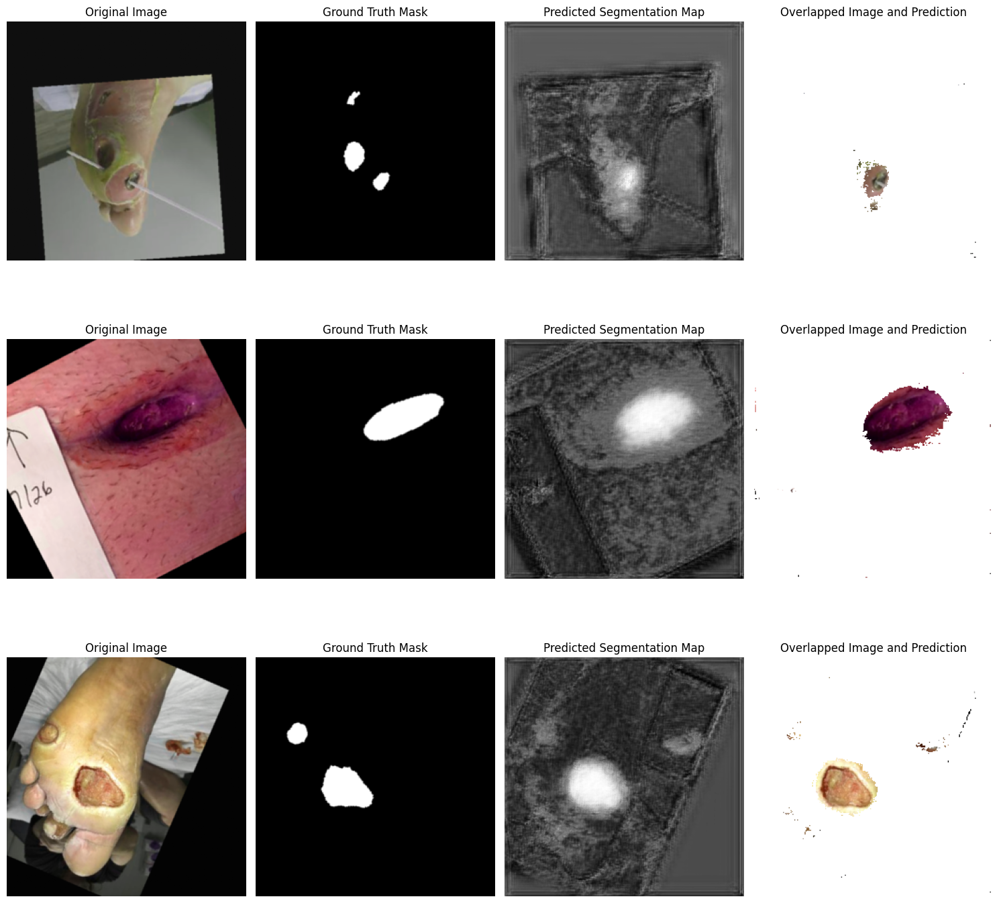

Validation loss decreased (inf --> 0.055308).  Saving model ...
Epoch 1/100, Training Loss: 0.9155, Validation Loss: 0.0553, Validation Dice: 0.7024,Validation IOU: 0.4417


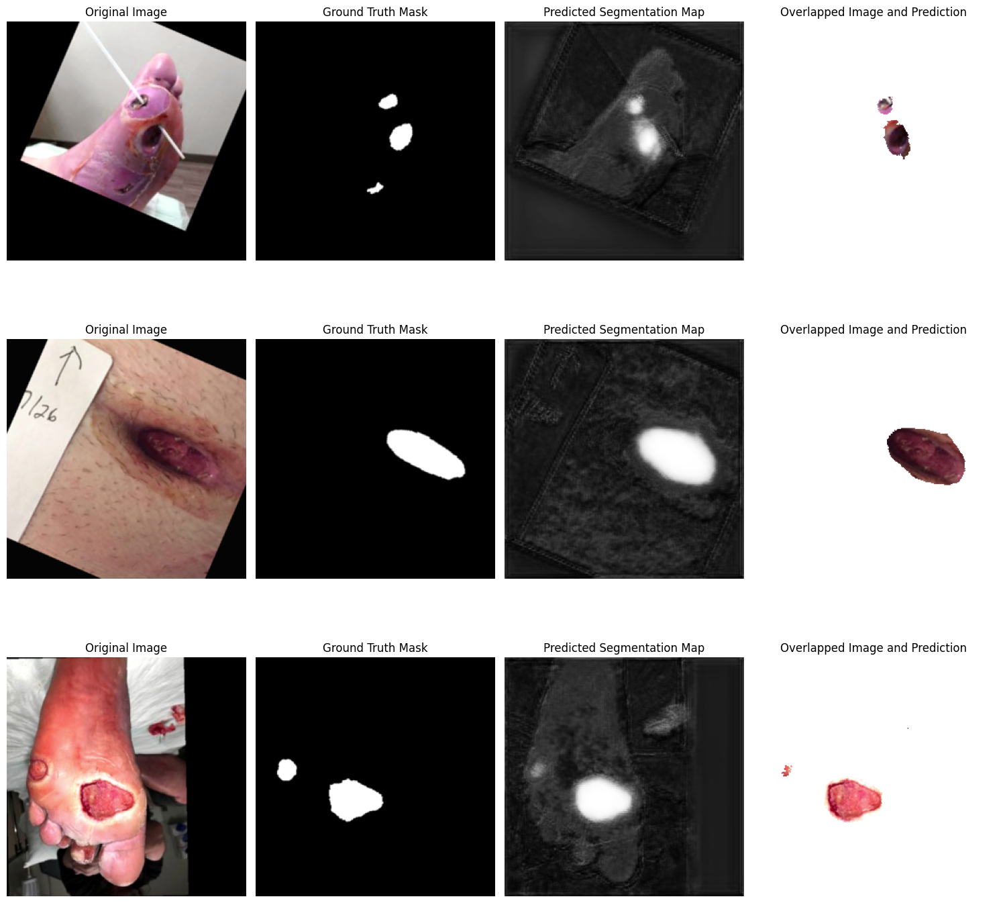

Validation loss decreased (0.055308 --> 0.048477).  Saving model ...
Epoch 2/100, Training Loss: 0.8274, Validation Loss: 0.0485, Validation Dice: 0.7910,Validation IOU: 0.5502


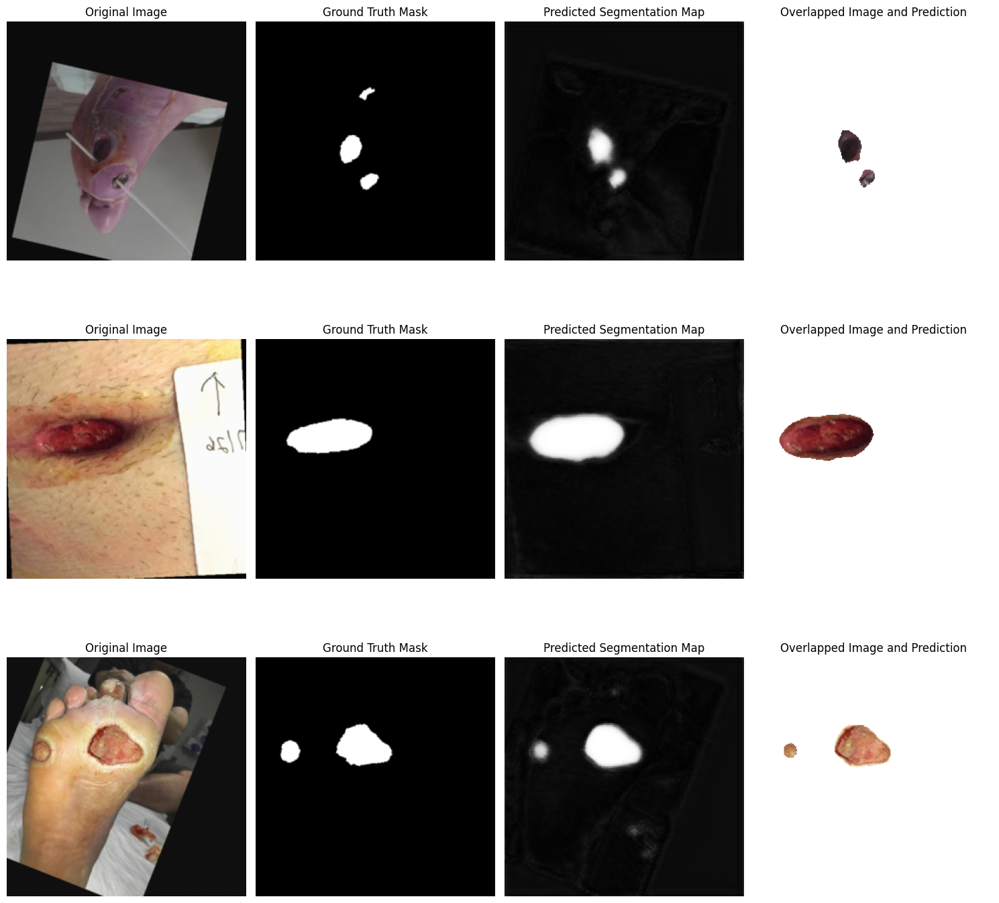

Validation loss decreased (0.048477 --> 0.039552).  Saving model ...
Epoch 3/100, Training Loss: 0.7119, Validation Loss: 0.0396, Validation Dice: 0.8160,Validation IOU: 0.6157


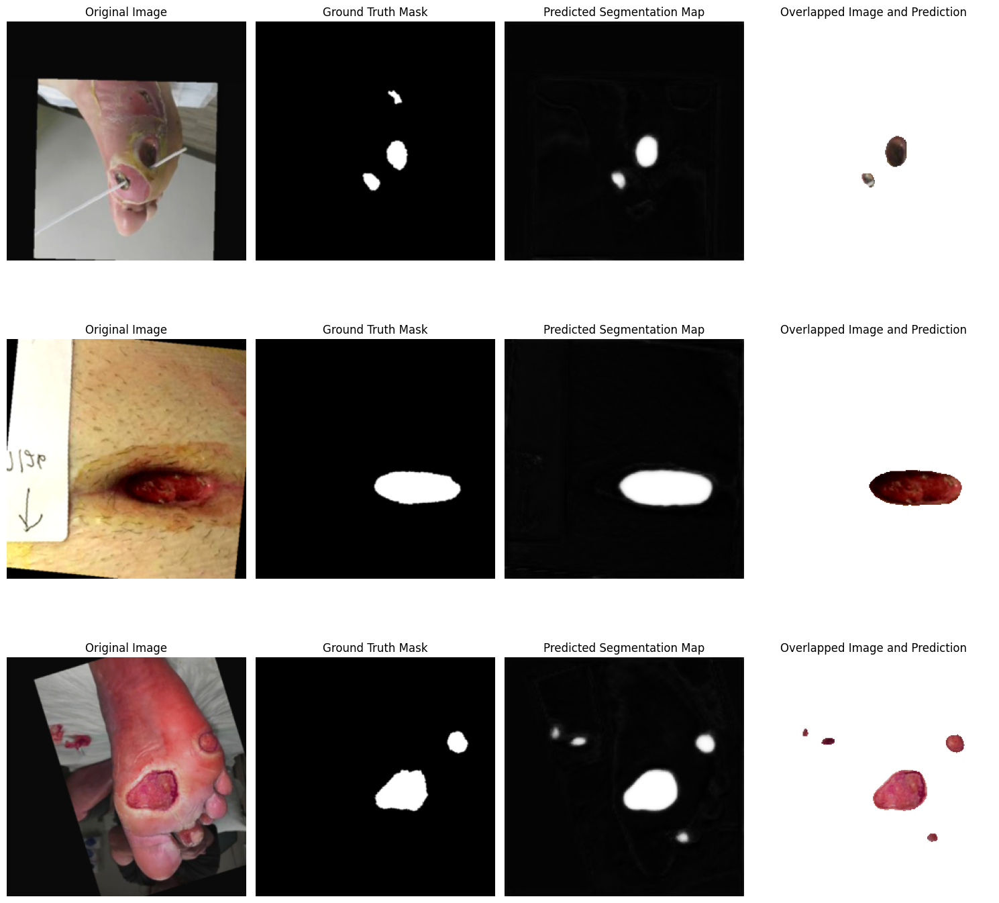

Validation loss decreased (0.039552 --> 0.030099).  Saving model ...
Epoch 4/100, Training Loss: 0.5680, Validation Loss: 0.0301, Validation Dice: 0.8882,Validation IOU: 0.6971


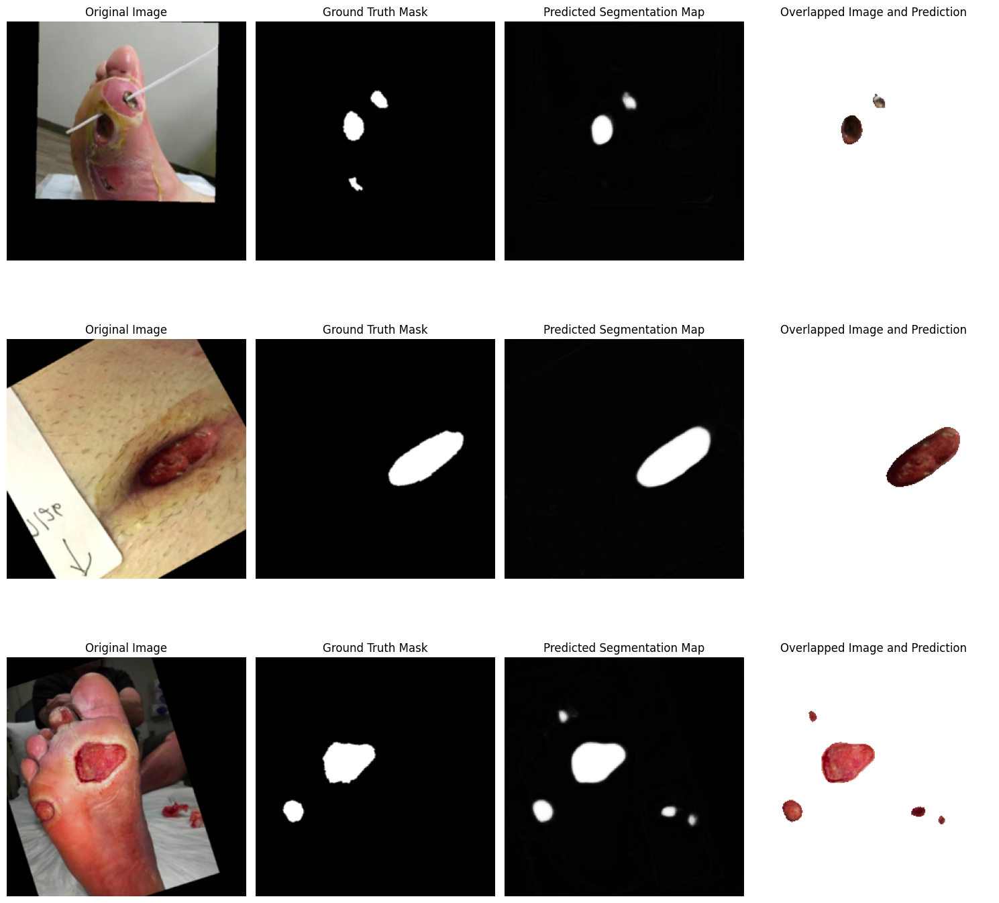

Validation loss decreased (0.030099 --> 0.023692).  Saving model ...
Epoch 5/100, Training Loss: 0.4458, Validation Loss: 0.0237, Validation Dice: 0.8930,Validation IOU: 0.7259


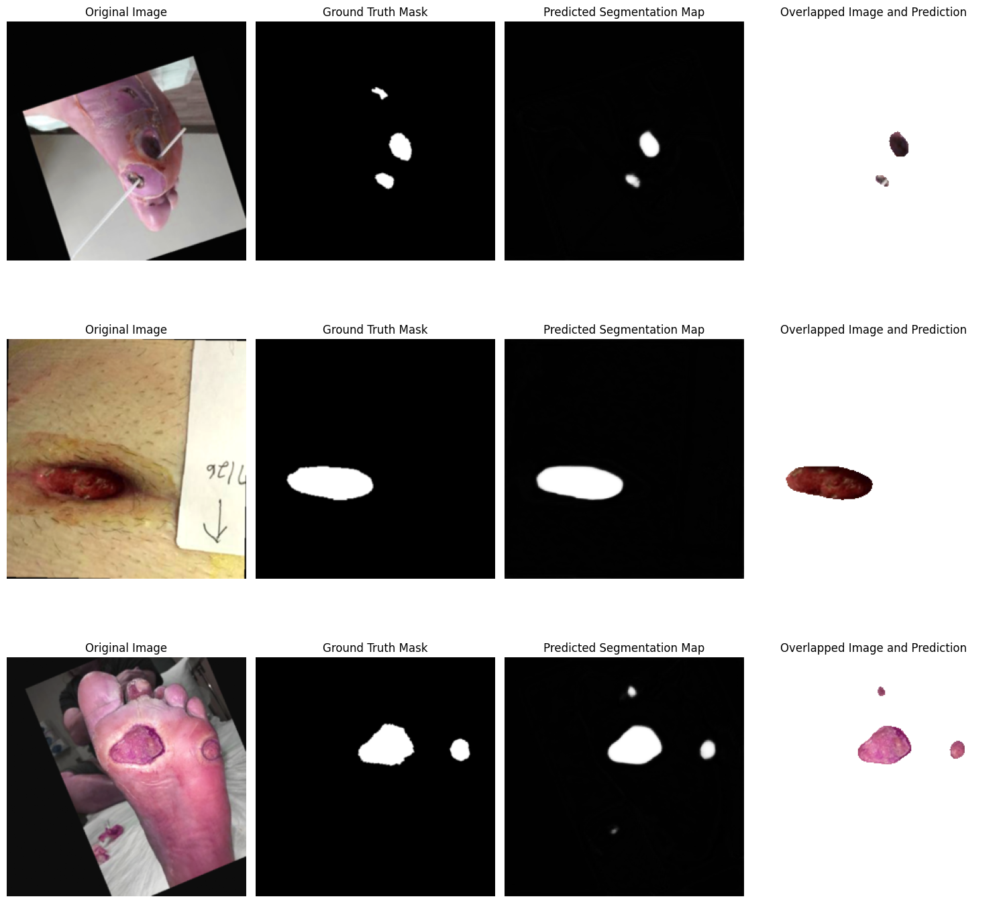

Validation loss decreased (0.023692 --> 0.019844).  Saving model ...
Epoch 6/100, Training Loss: 0.3528, Validation Loss: 0.0198, Validation Dice: 0.9045,Validation IOU: 0.7423


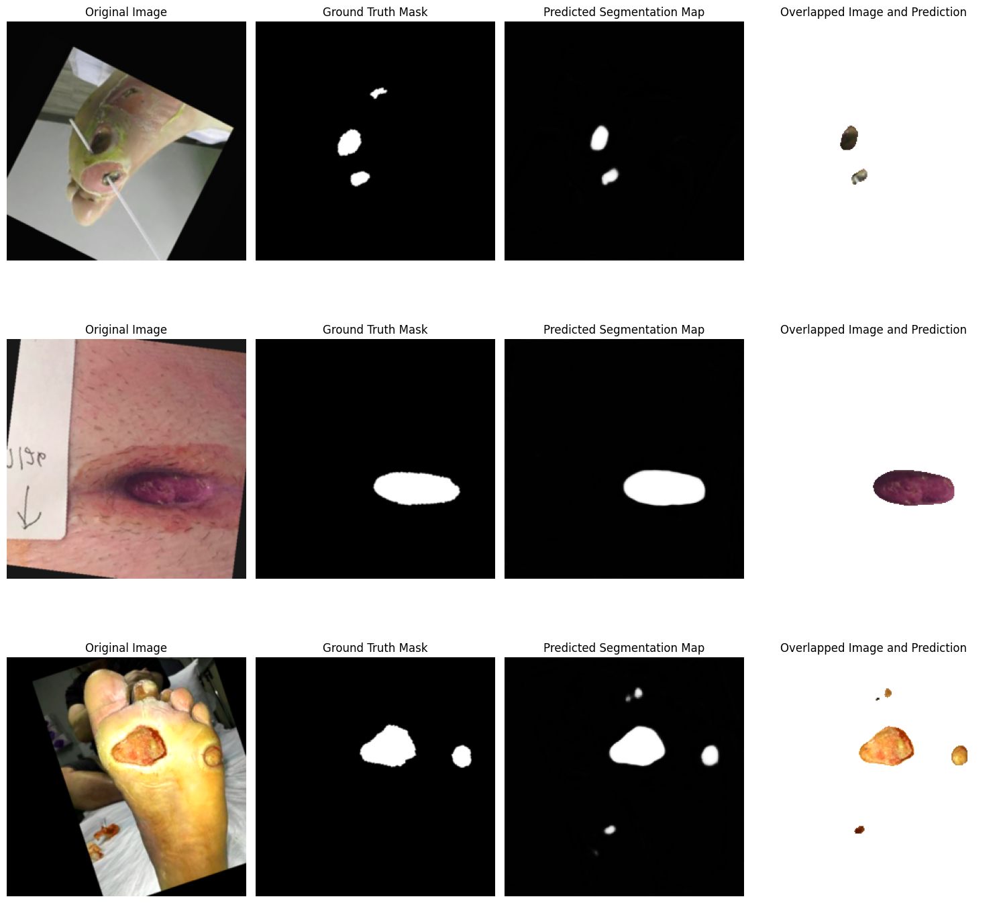

Validation loss decreased (0.019844 --> 0.016720).  Saving model ...
Epoch 7/100, Training Loss: 0.2906, Validation Loss: 0.0167, Validation Dice: 0.9091,Validation IOU: 0.7473


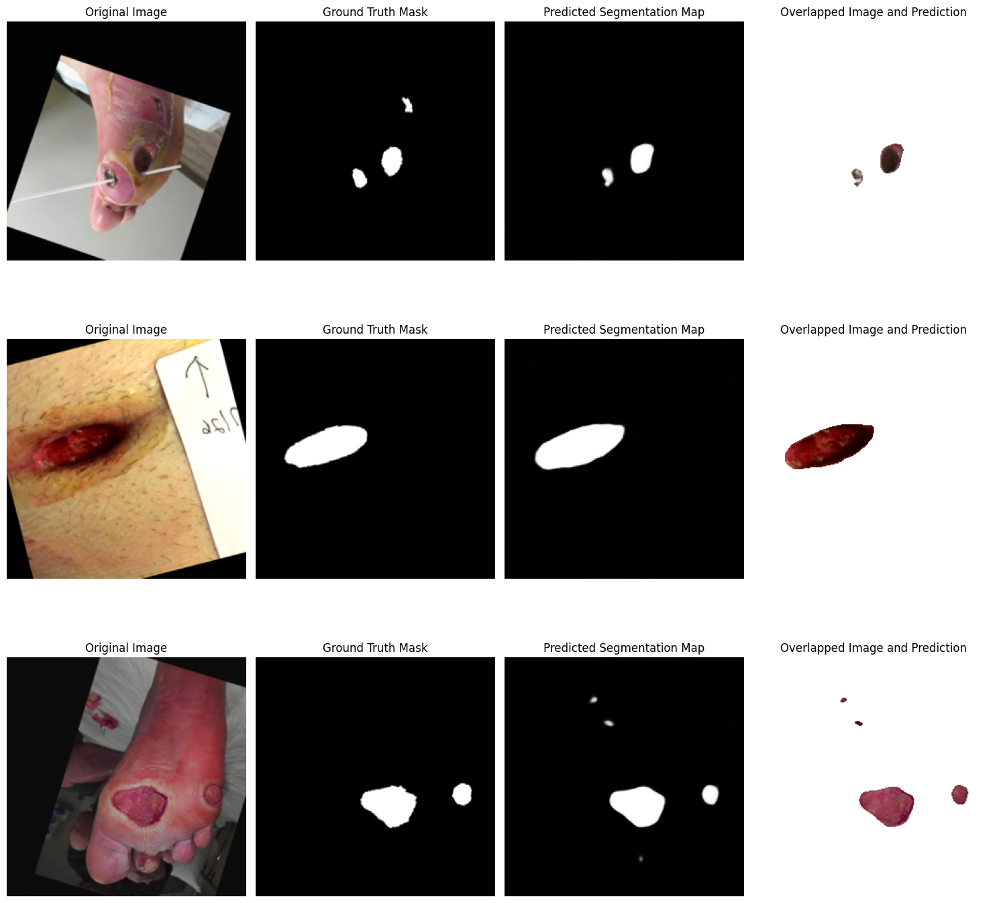

Validation loss decreased (0.016720 --> 0.014854).  Saving model ...
Epoch 8/100, Training Loss: 0.2672, Validation Loss: 0.0149, Validation Dice: 0.9094,Validation IOU: 0.7520


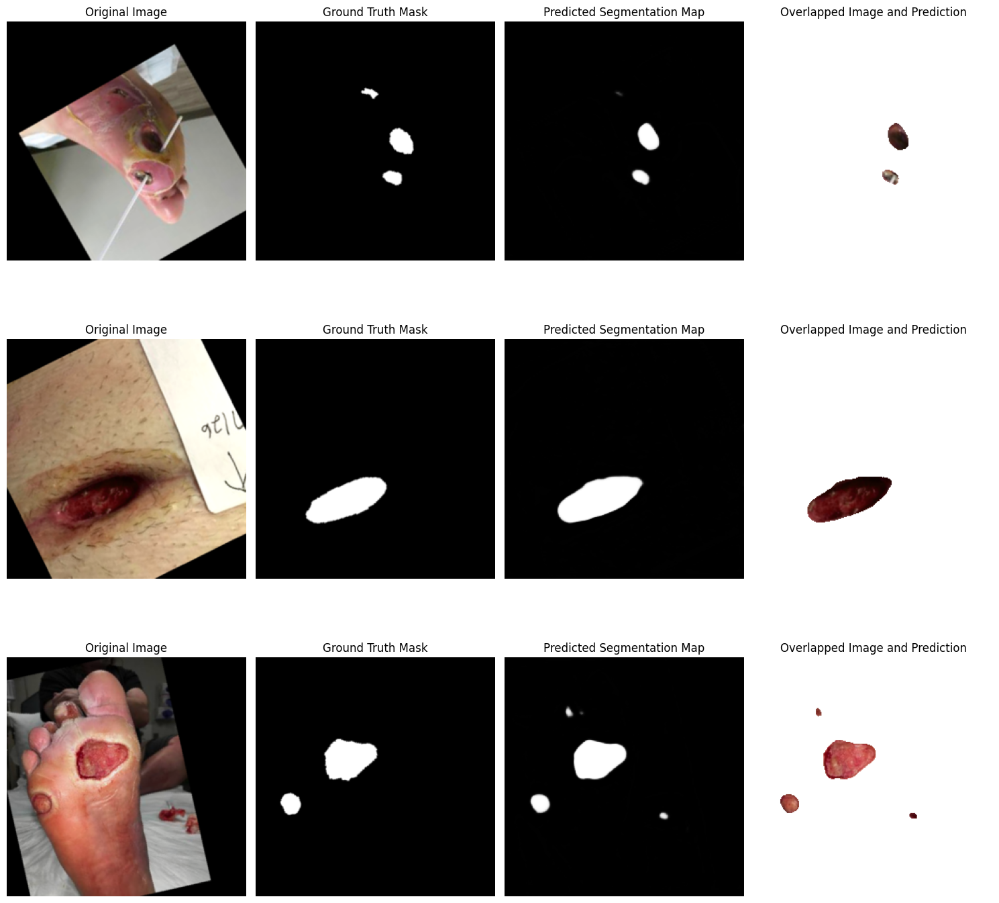

Validation loss decreased (0.014854 --> 0.014032).  Saving model ...
Epoch 9/100, Training Loss: 0.2243, Validation Loss: 0.0140, Validation Dice: 0.9112,Validation IOU: 0.7543


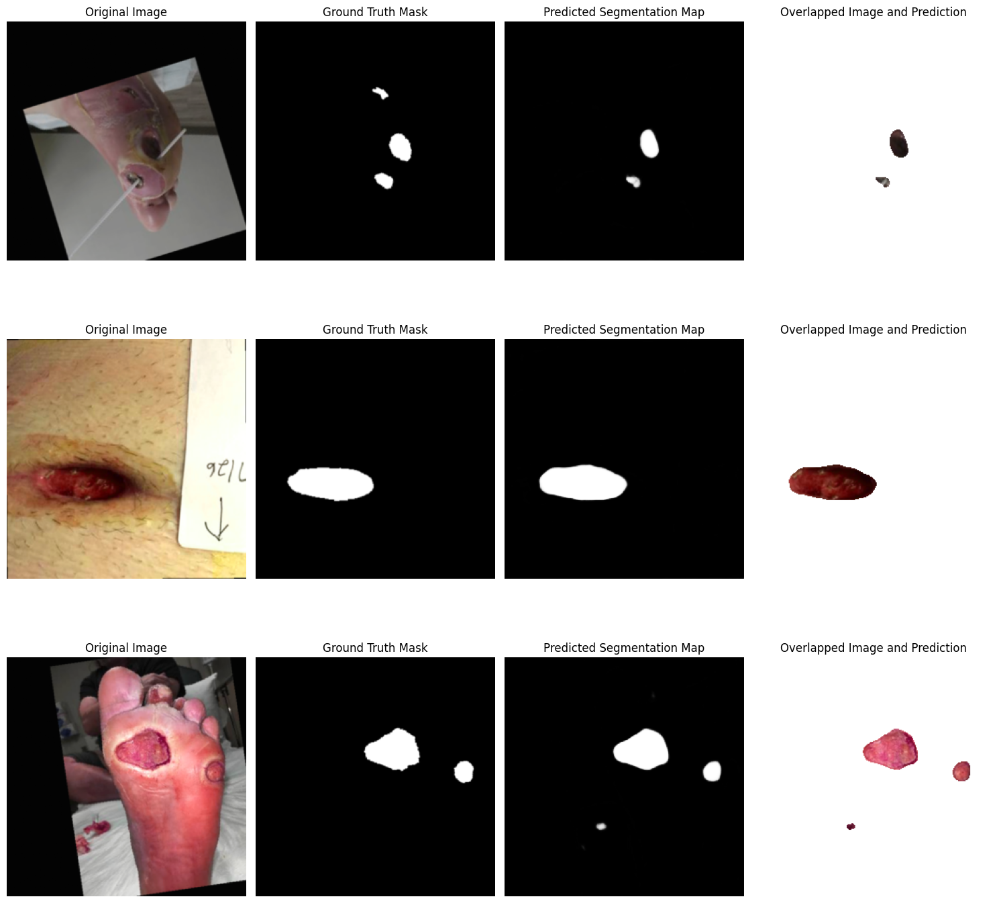

Validation loss decreased (0.014032 --> 0.013205).  Saving model ...
Epoch 10/100, Training Loss: 0.2042, Validation Loss: 0.0132, Validation Dice: 0.9120,Validation IOU: 0.7649


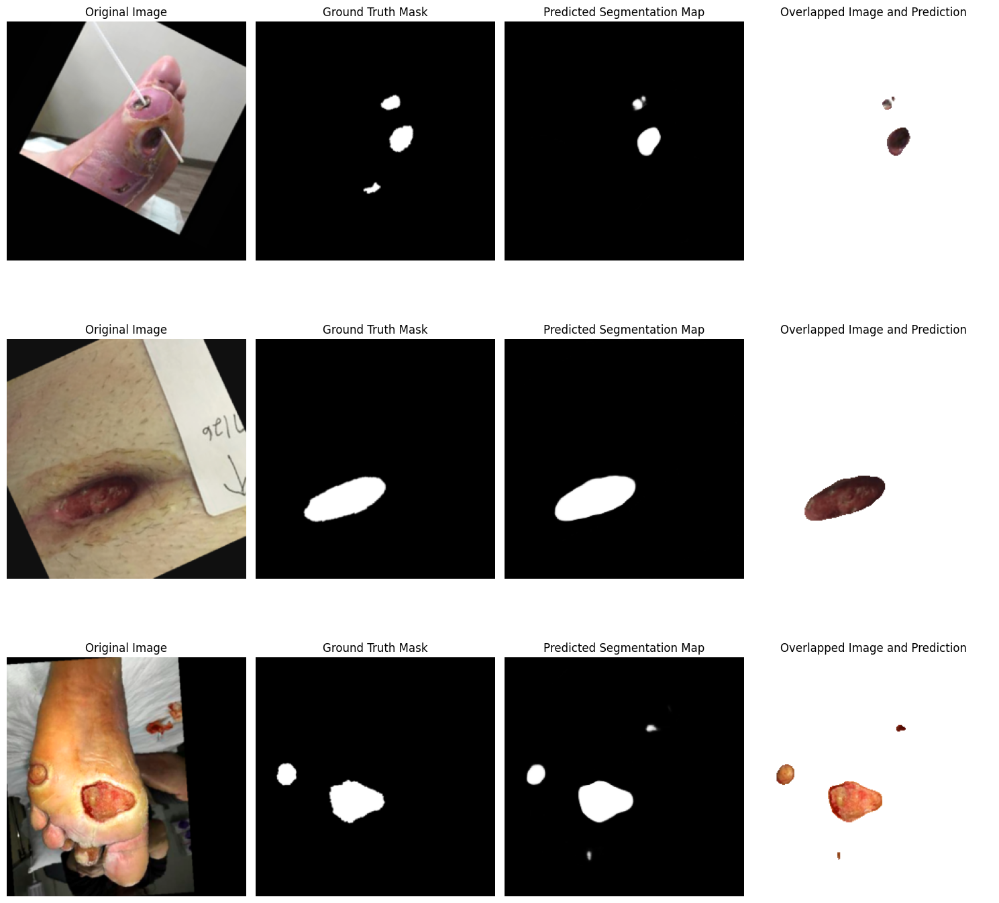

Validation loss decreased (0.013205 --> 0.012269).  Saving model ...
Epoch 11/100, Training Loss: 0.1884, Validation Loss: 0.0123, Validation Dice: 0.9147,Validation IOU: 0.7673


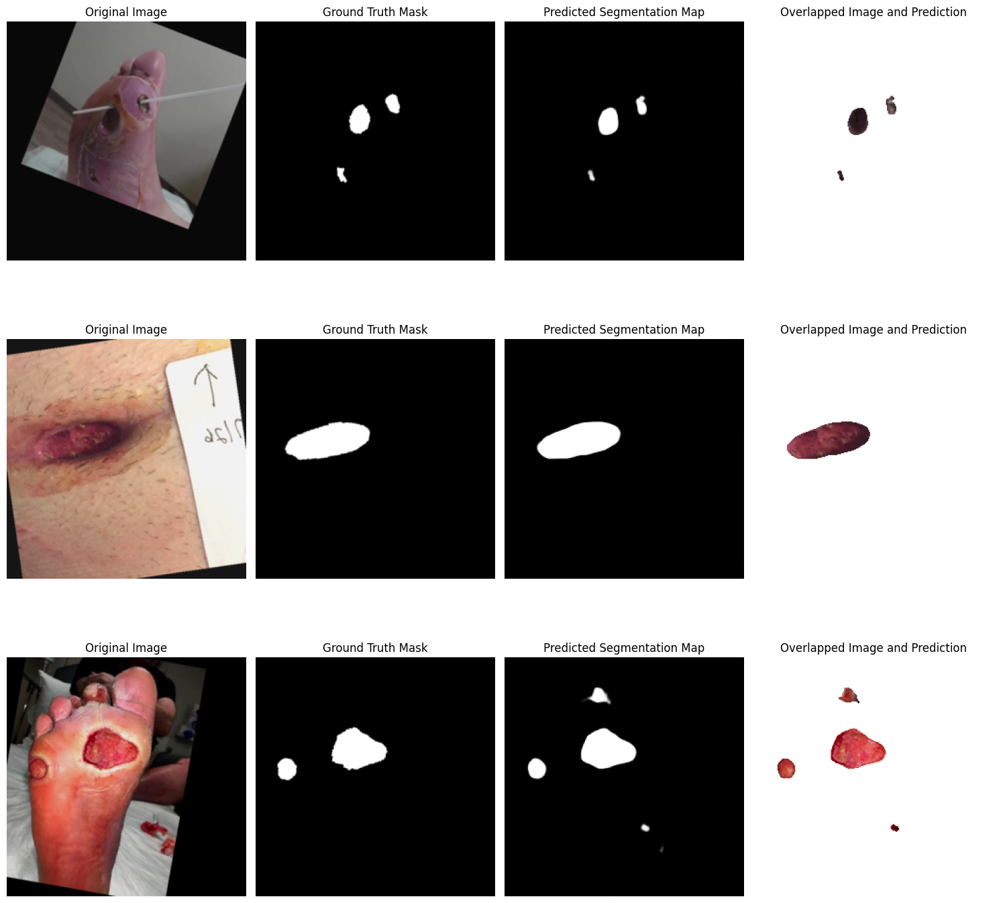

Validation loss decreased (0.012269 --> 0.011850).  Saving model ...
Epoch 12/100, Training Loss: 0.1679, Validation Loss: 0.0118, Validation Dice: 0.9168,Validation IOU: 0.7811


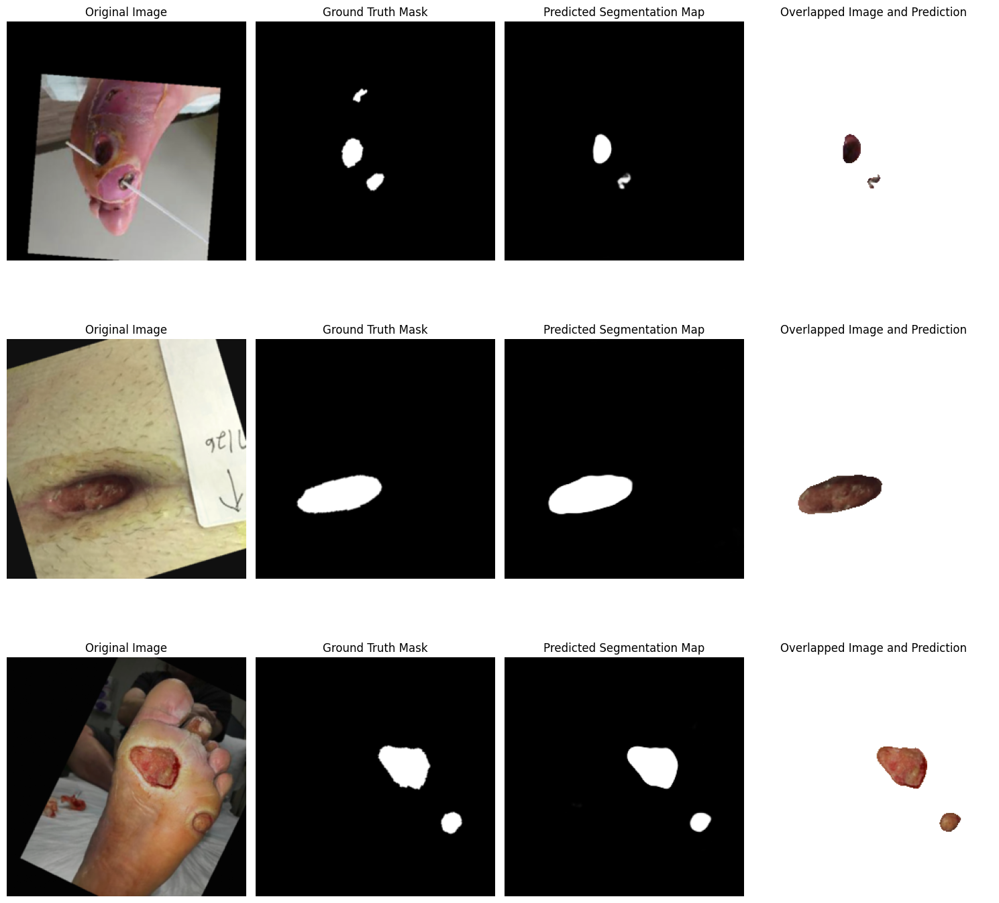

Validation loss decreased (0.011850 --> 0.011461).  Saving model ...
Epoch 13/100, Training Loss: 0.1610, Validation Loss: 0.0115, Validation Dice: 0.9171,Validation IOU: 0.7869


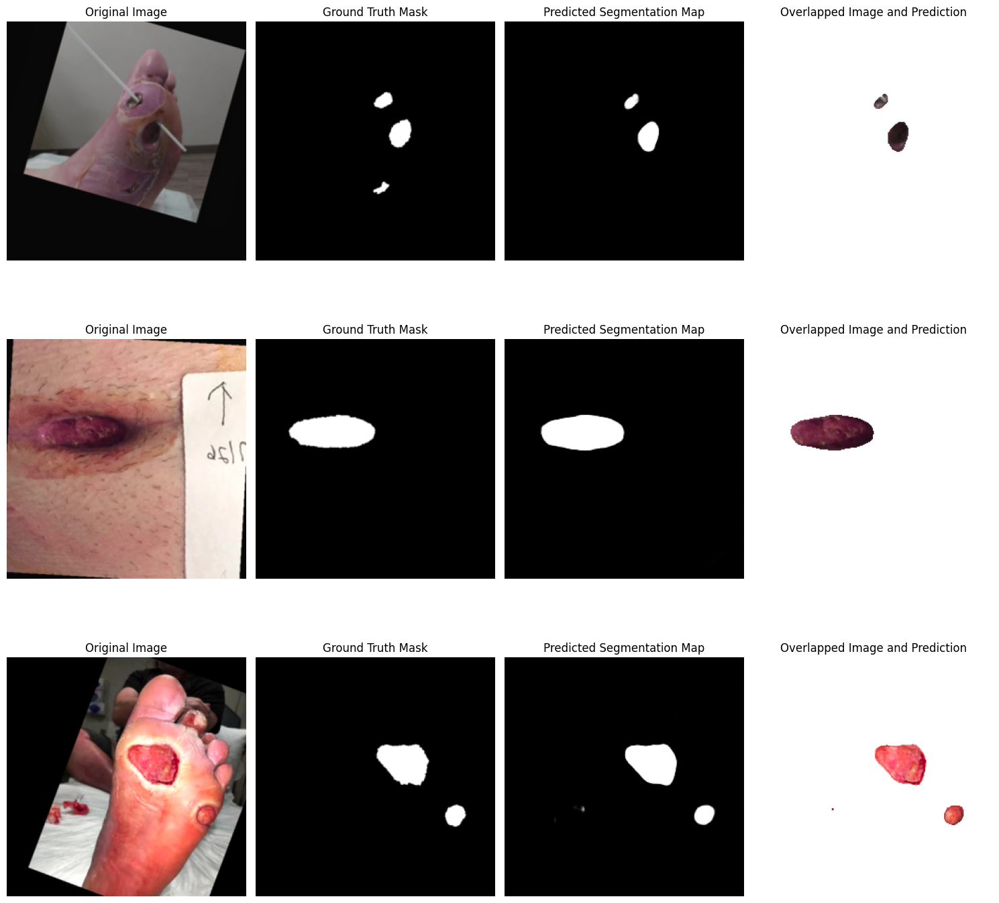

Validation loss decreased (0.011461 --> 0.011348).  Saving model ...
Epoch 14/100, Training Loss: 0.1575, Validation Loss: 0.0113, Validation Dice: 0.9162,Validation IOU: 0.7788


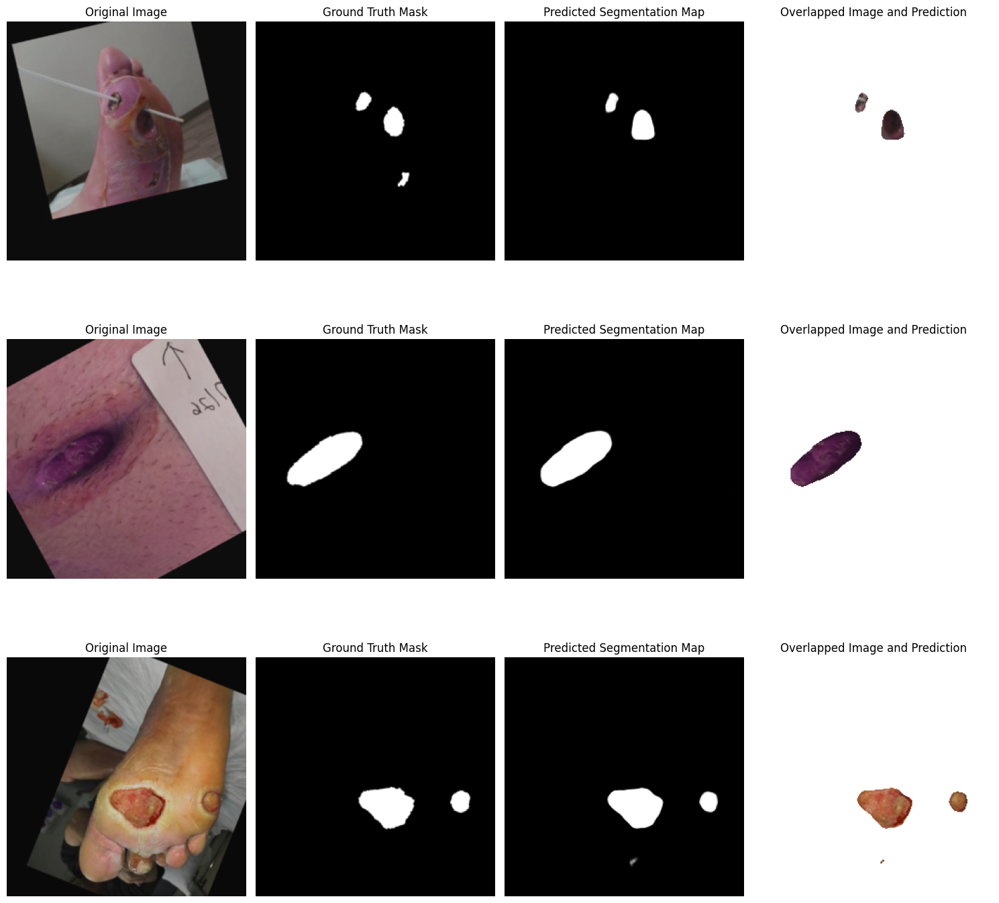

Validation loss decreased (0.011348 --> 0.010882).  Saving model ...
Epoch 15/100, Training Loss: 0.1529, Validation Loss: 0.0109, Validation Dice: 0.9185,Validation IOU: 0.7790


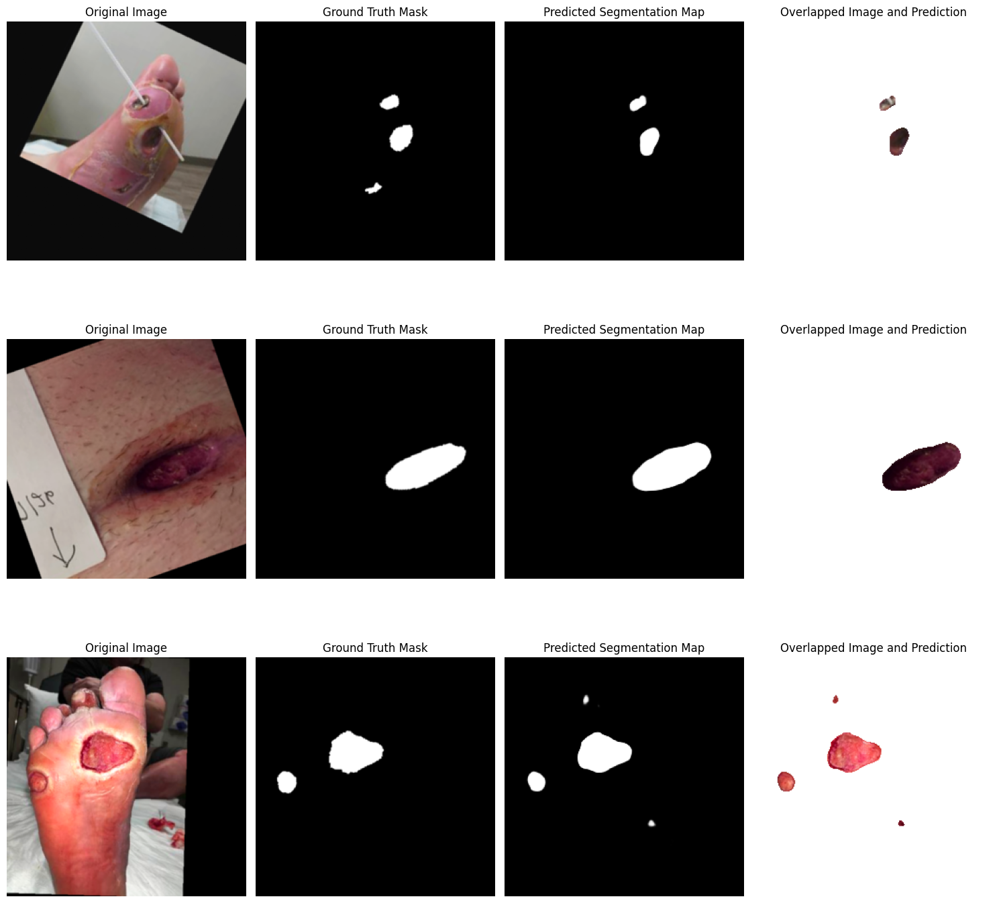

Validation loss decreased (0.010882 --> 0.010610).  Saving model ...
Epoch 16/100, Training Loss: 0.1415, Validation Loss: 0.0106, Validation Dice: 0.9199,Validation IOU: 0.7774


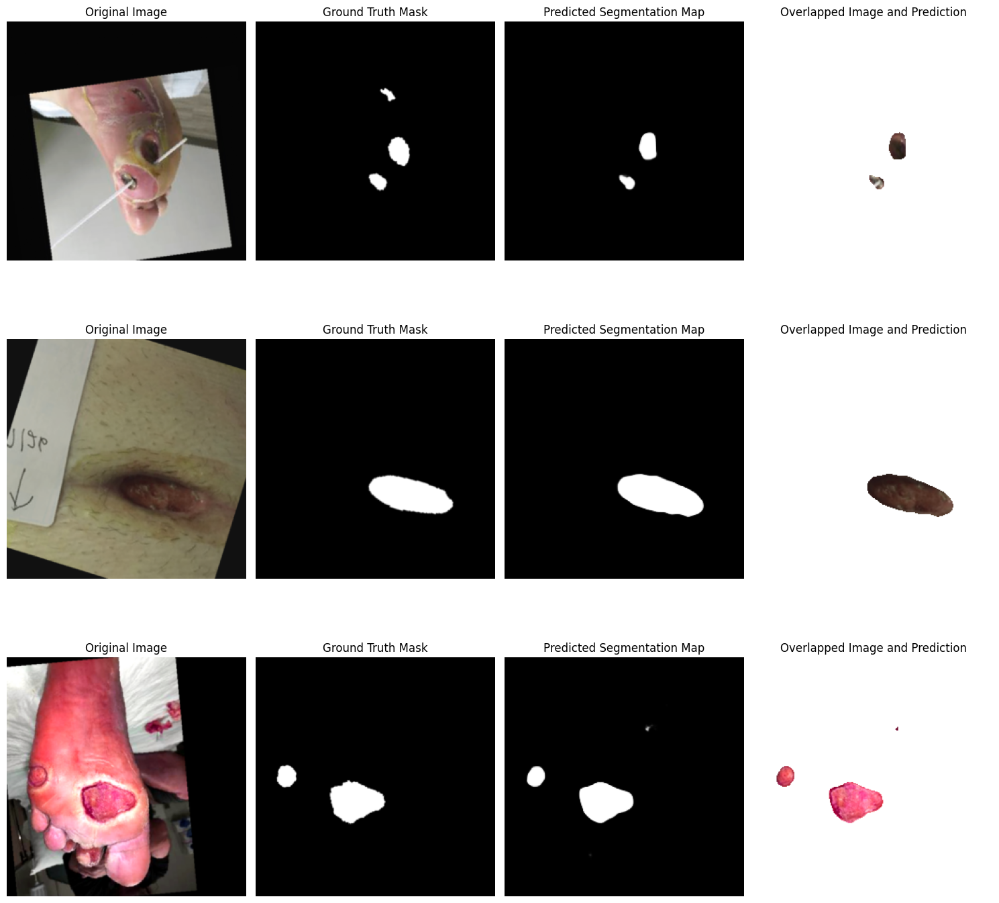

Validation loss decreased (0.010610 --> 0.010151).  Saving model ...
Epoch 17/100, Training Loss: 0.1336, Validation Loss: 0.0102, Validation Dice: 0.9225,Validation IOU: 0.7900


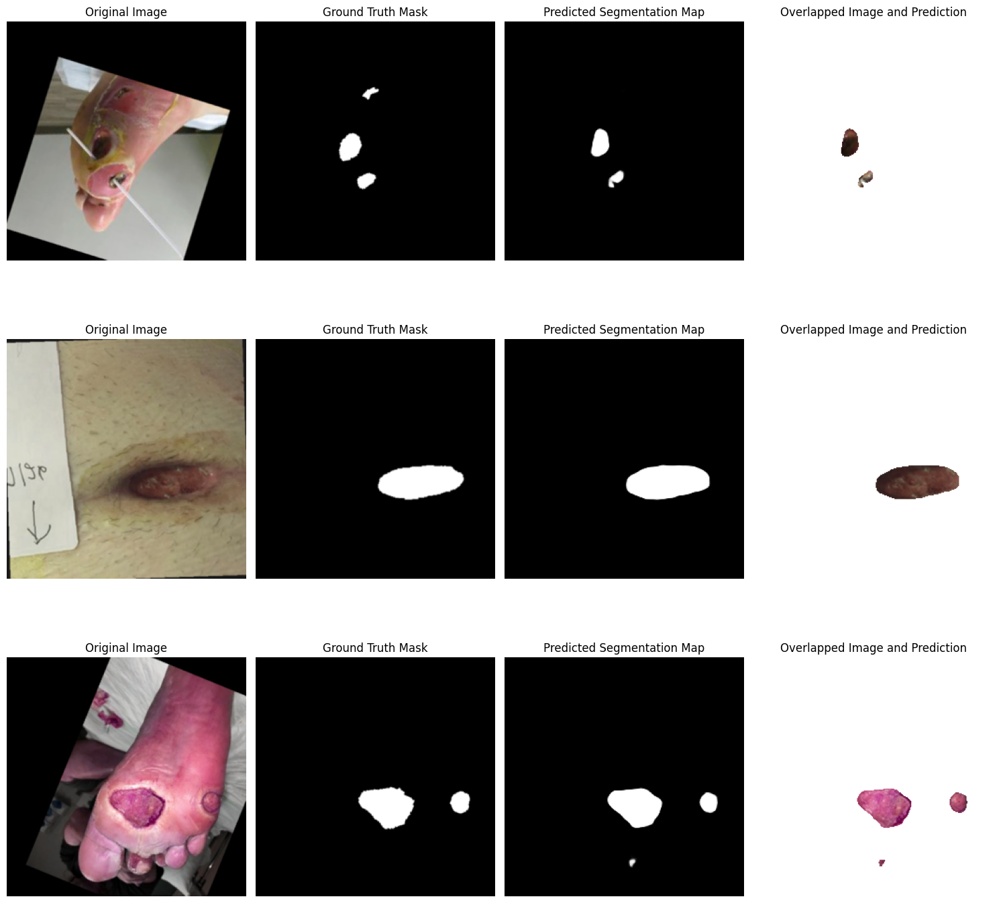

Validation loss decreased (0.010151 --> 0.009745).  Saving model ...
Epoch 18/100, Training Loss: 0.1300, Validation Loss: 0.0097, Validation Dice: 0.9255,Validation IOU: 0.7889


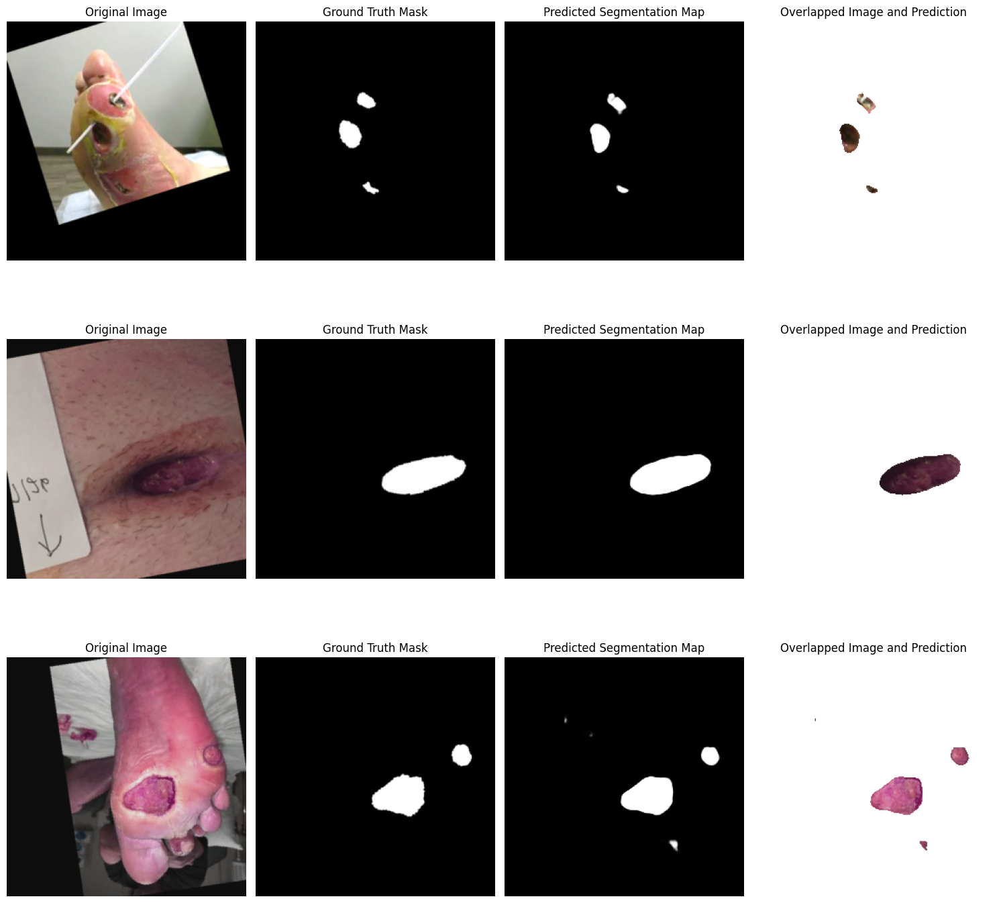

Epoch 19/100, Training Loss: 0.1306, Validation Loss: 0.0099, Validation Dice: 0.9229,Validation IOU: 0.7916


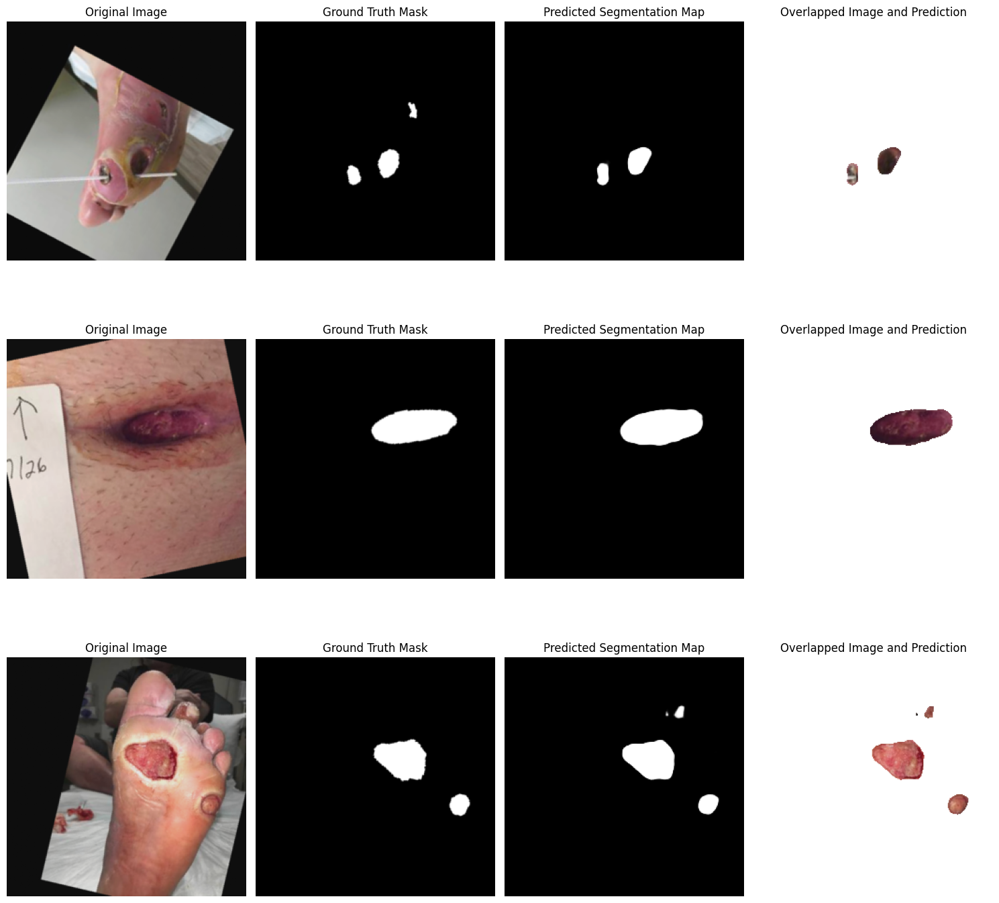

Epoch 20/100, Training Loss: 0.1273, Validation Loss: 0.0099, Validation Dice: 0.9229,Validation IOU: 0.7867


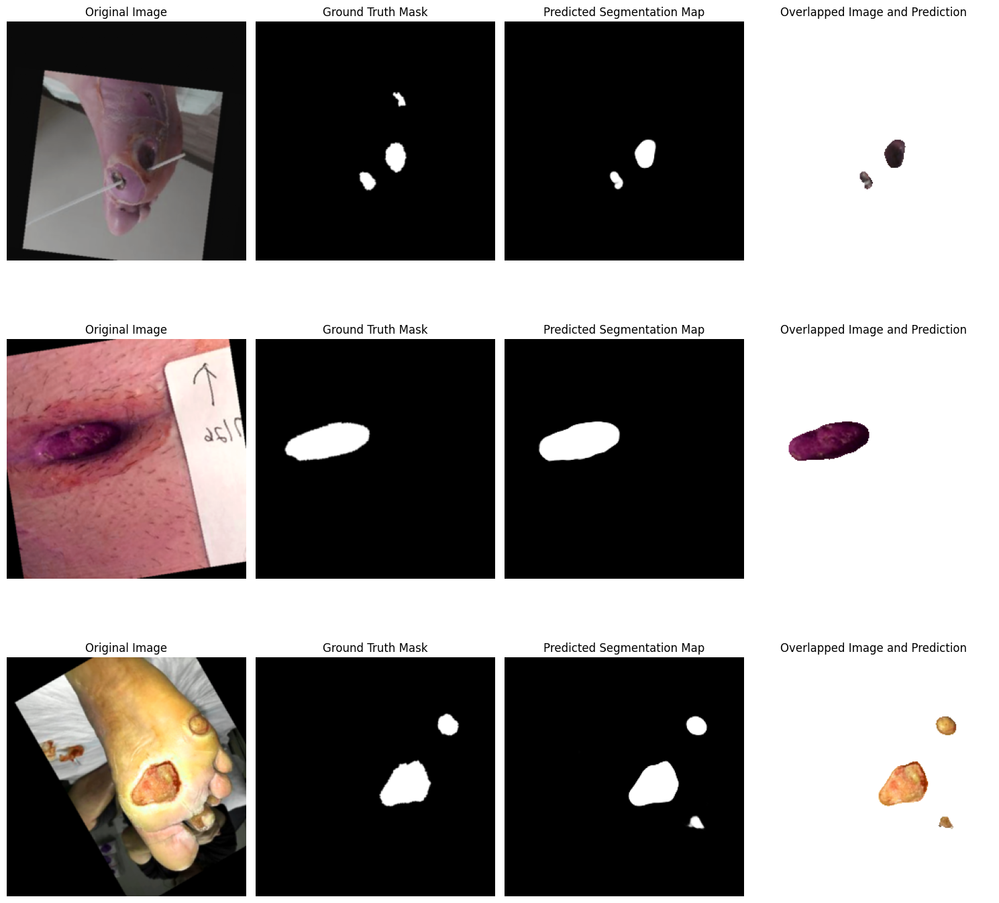

Epoch 21/100, Training Loss: 0.1223, Validation Loss: 0.0098, Validation Dice: 0.9228,Validation IOU: 0.7901


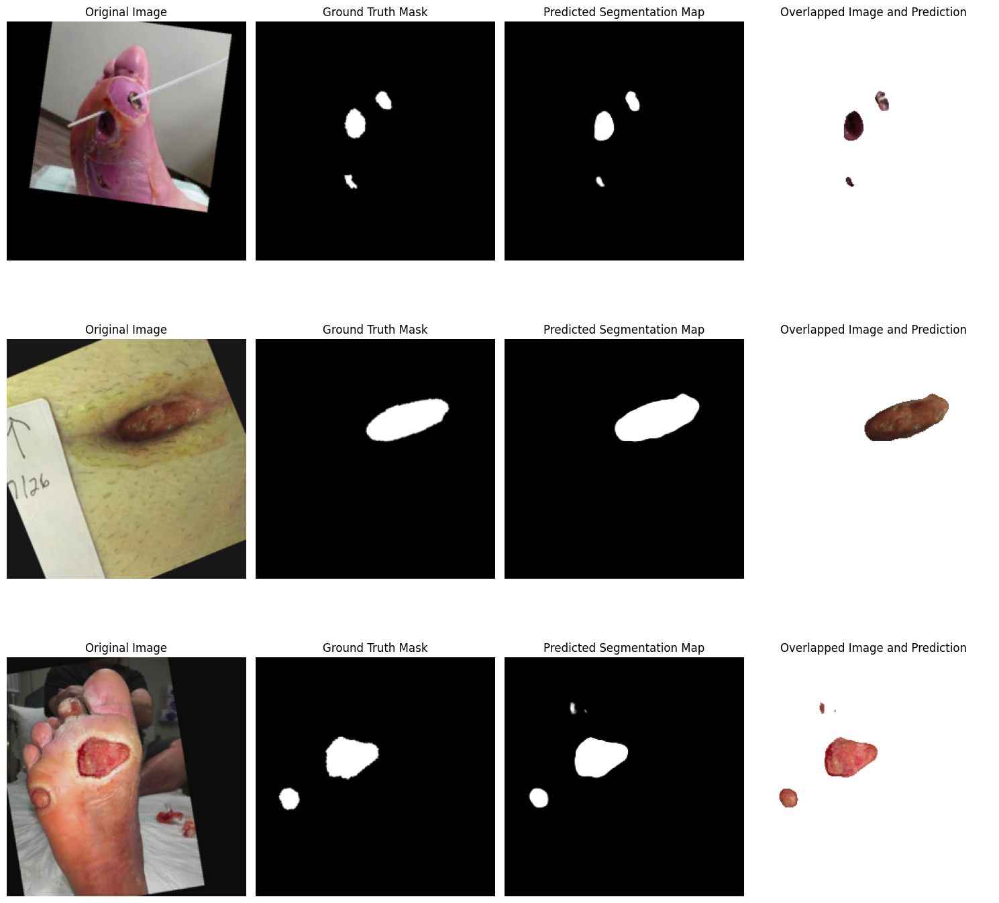

Epoch 22/100, Training Loss: 0.1219, Validation Loss: 0.0098, Validation Dice: 0.9220,Validation IOU: 0.7897


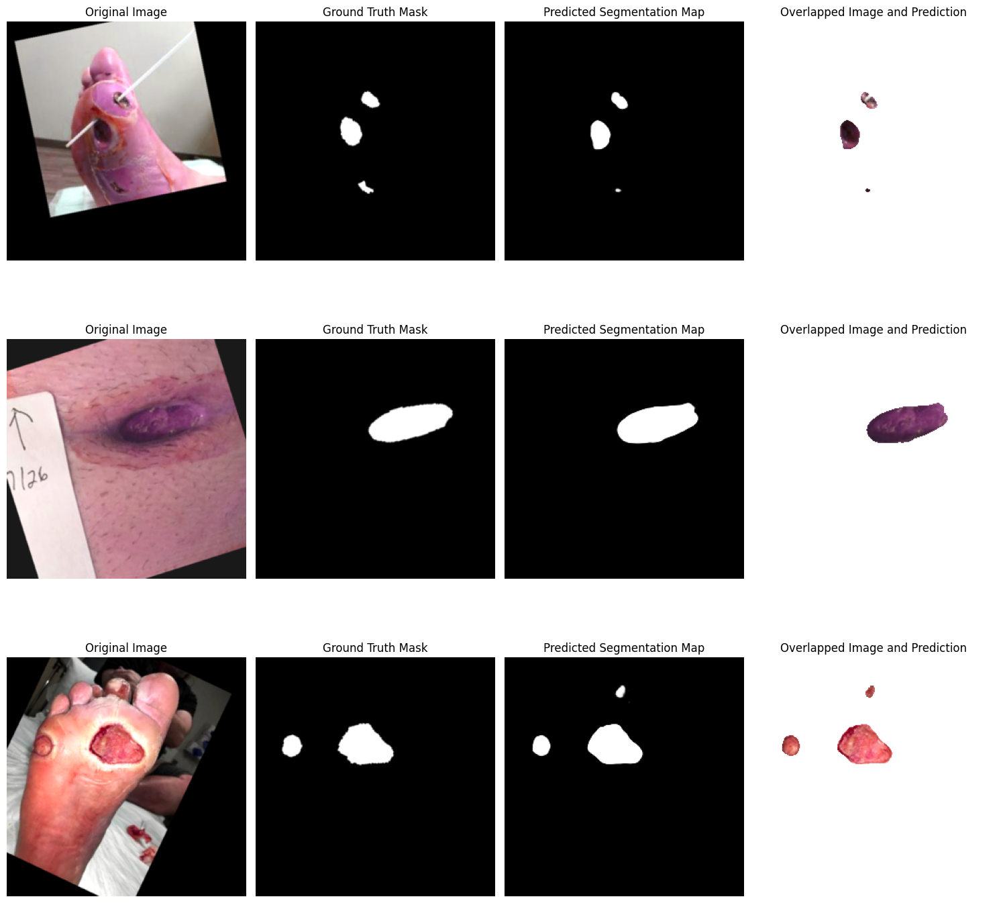

Validation loss decreased (0.009745 --> 0.009347).  Saving model ...
Epoch 23/100, Training Loss: 0.1162, Validation Loss: 0.0093, Validation Dice: 0.9249,Validation IOU: 0.8013


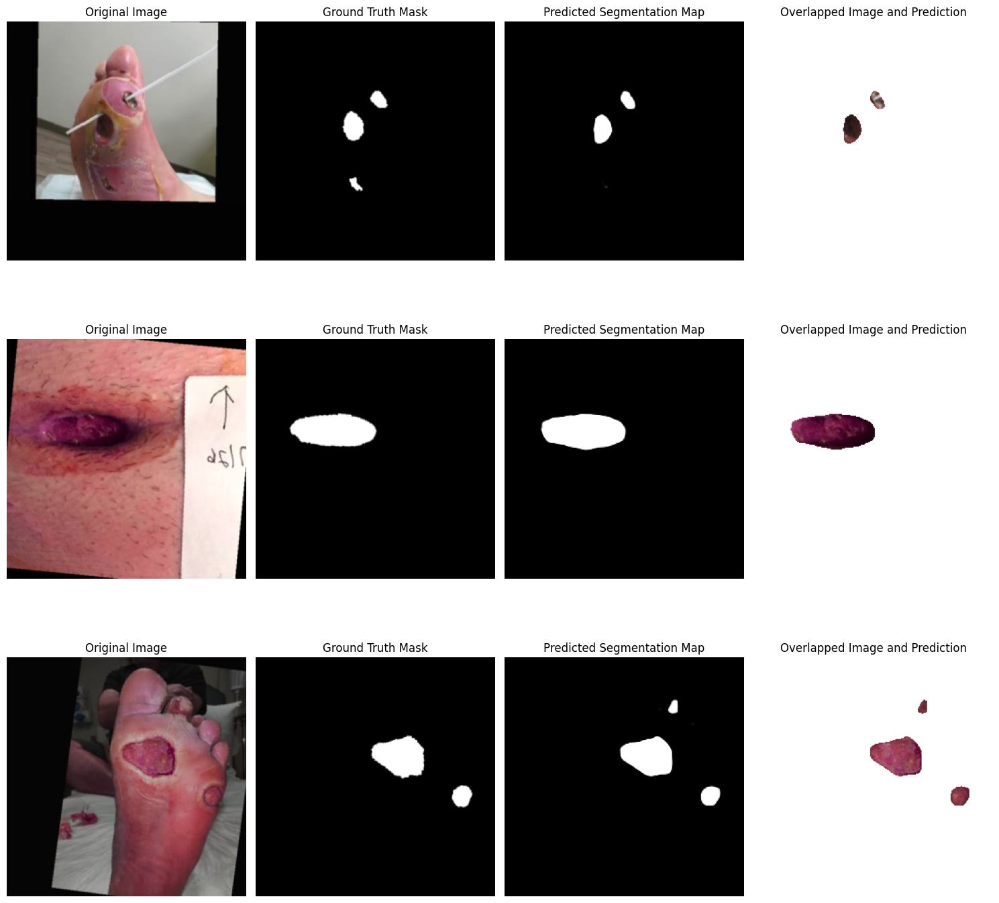

Epoch 24/100, Training Loss: 0.1120, Validation Loss: 0.0097, Validation Dice: 0.9225,Validation IOU: 0.7810


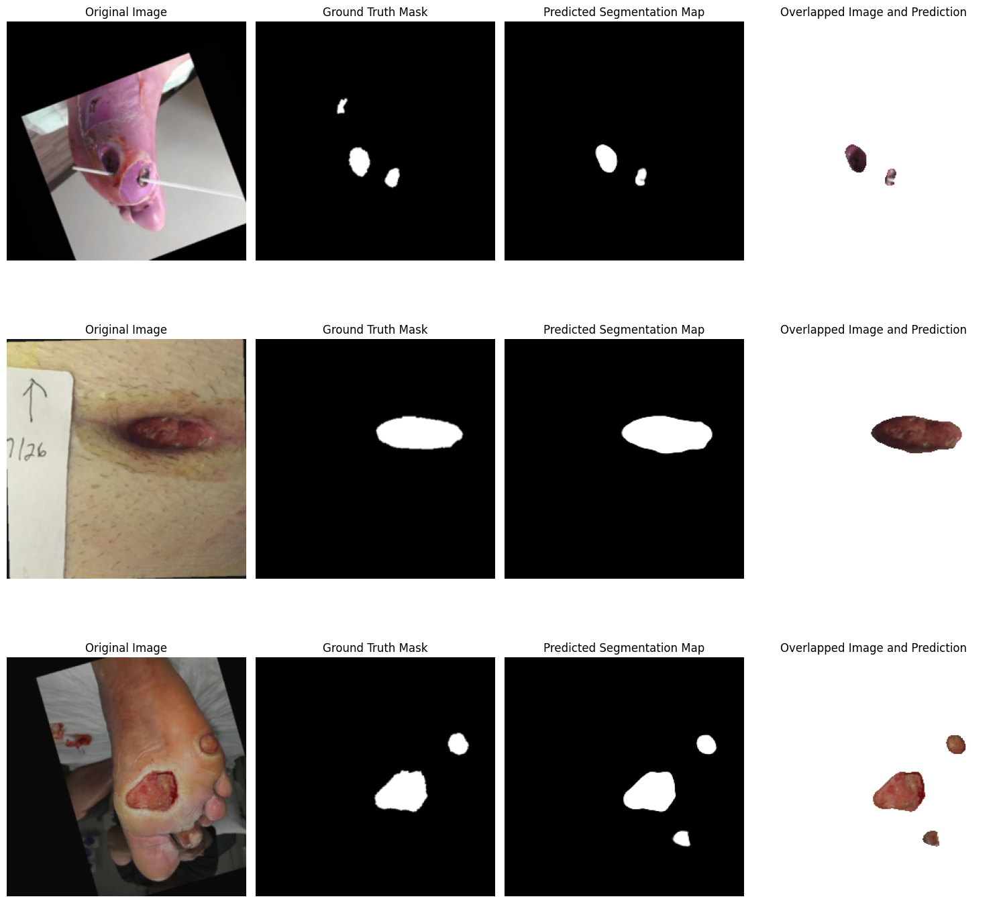

Epoch 25/100, Training Loss: 0.1090, Validation Loss: 0.0097, Validation Dice: 0.9221,Validation IOU: 0.7904


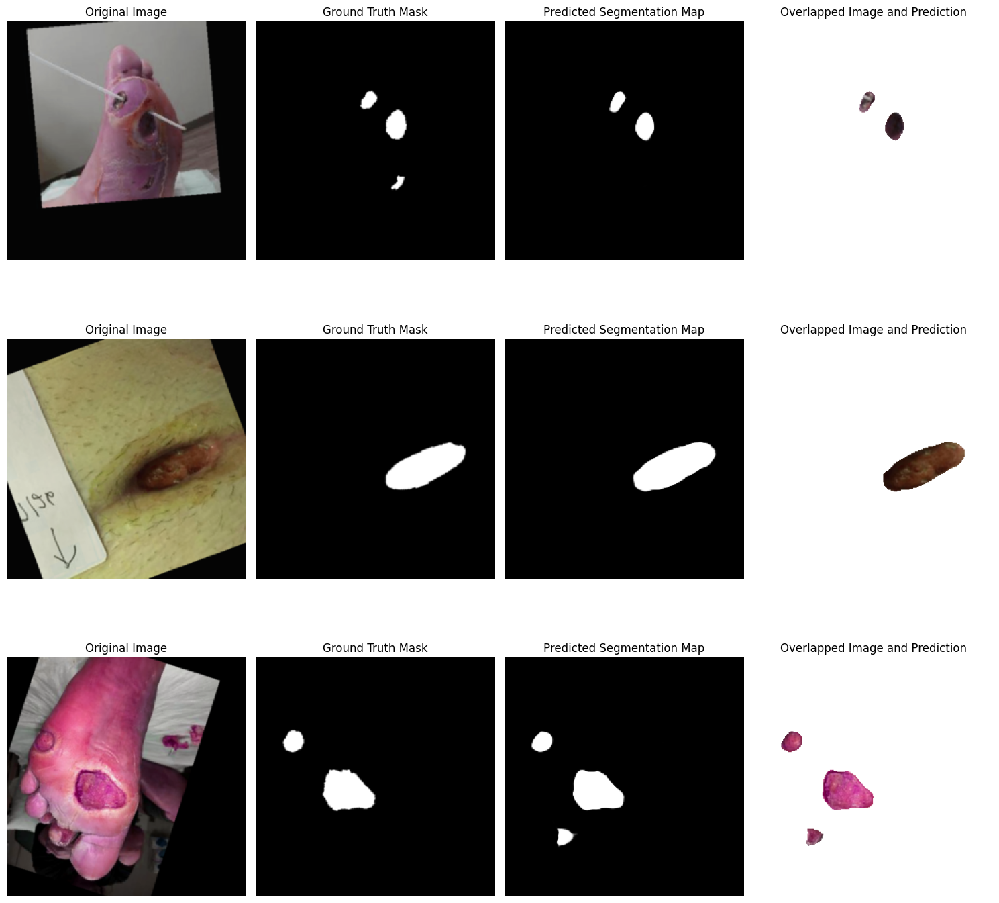

Epoch 26/100, Training Loss: 0.1059, Validation Loss: 0.0095, Validation Dice: 0.9236,Validation IOU: 0.7940


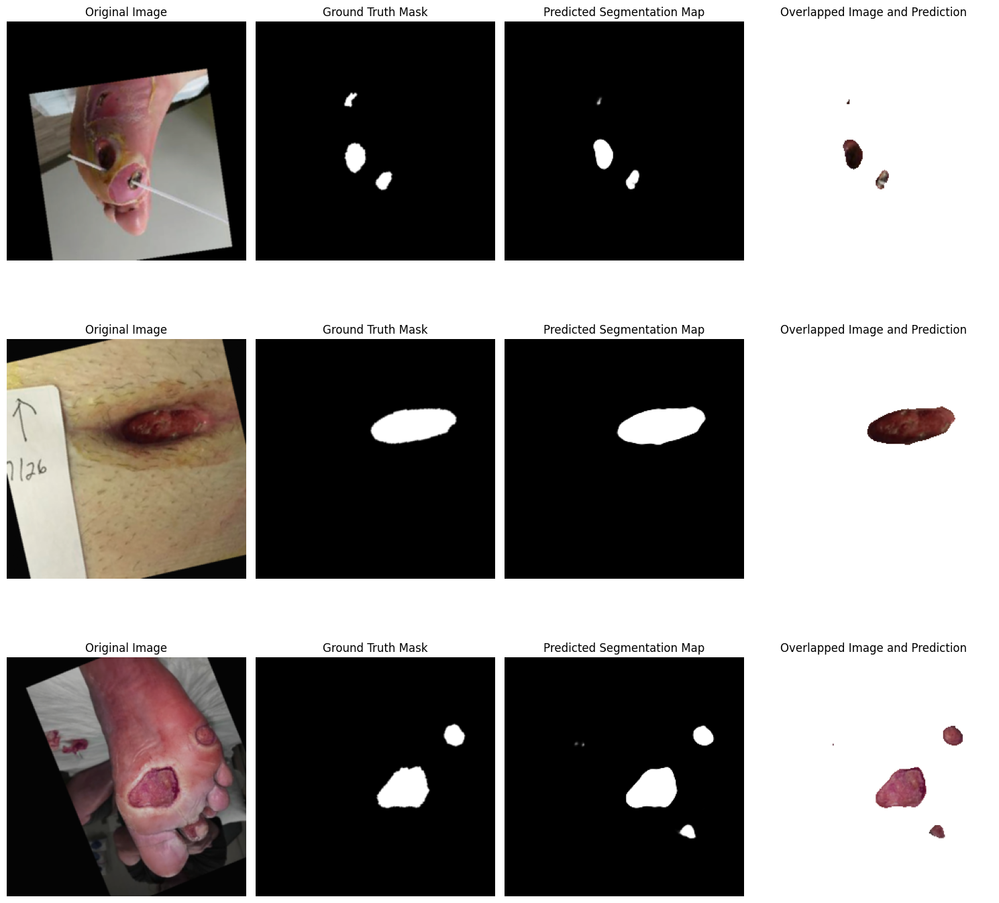

Validation loss decreased (0.009347 --> 0.009282).  Saving model ...
Epoch 27/100, Training Loss: 0.1067, Validation Loss: 0.0093, Validation Dice: 0.9255,Validation IOU: 0.7981


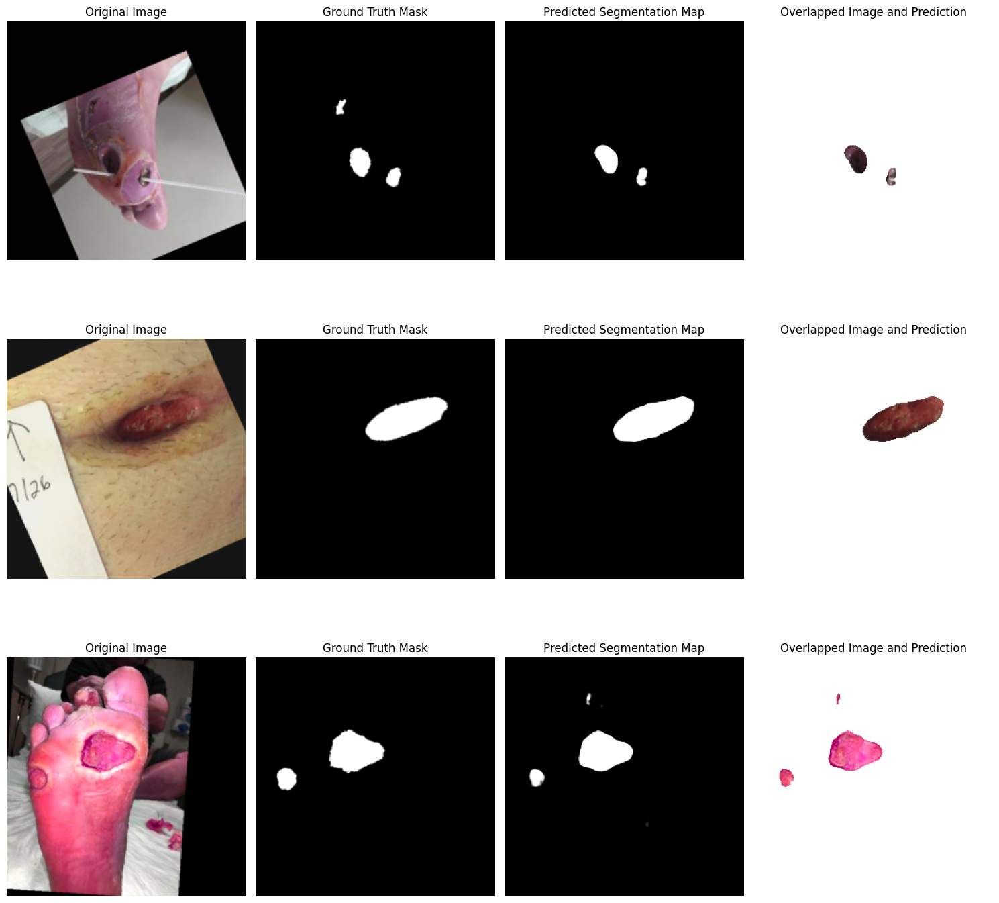

Epoch 28/100, Training Loss: 0.1090, Validation Loss: 0.0096, Validation Dice: 0.9225,Validation IOU: 0.7976


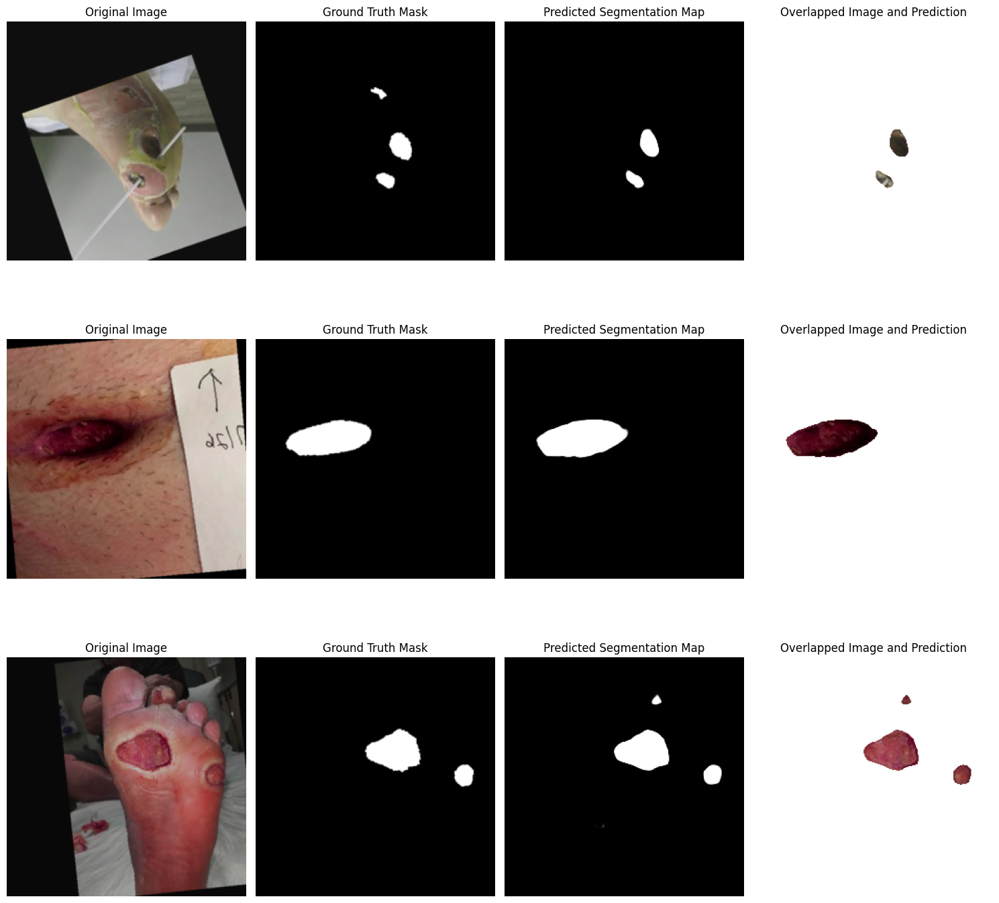

Epoch 29/100, Training Loss: 0.1048, Validation Loss: 0.0093, Validation Dice: 0.9244,Validation IOU: 0.7851


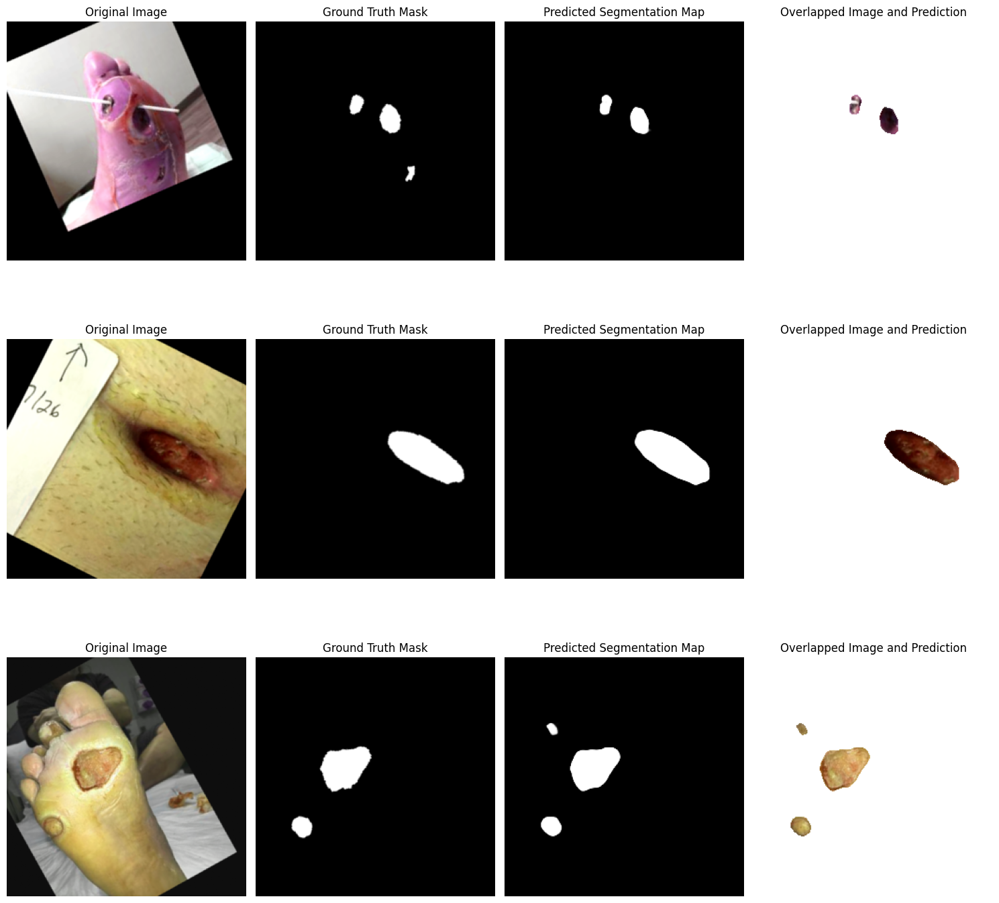

Validation loss decreased (0.009282 --> 0.009147).  Saving model ...
Epoch 30/100, Training Loss: 0.1031, Validation Loss: 0.0091, Validation Dice: 0.9257,Validation IOU: 0.8047


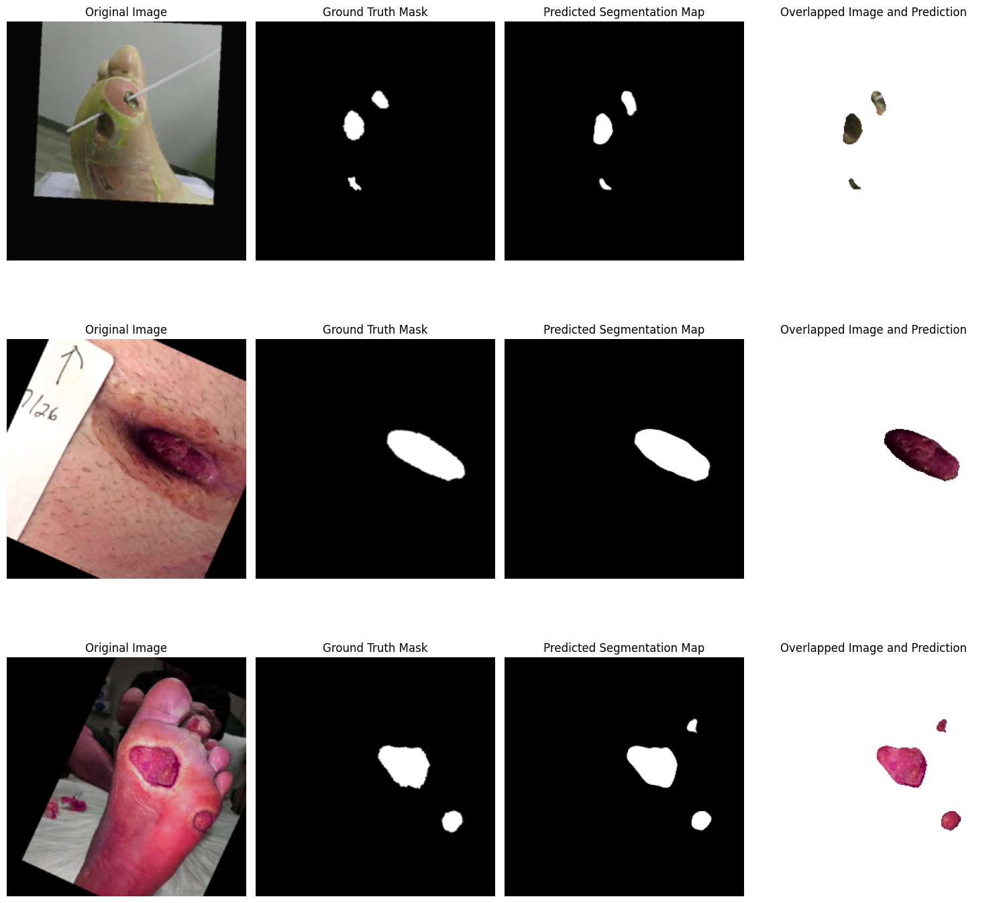

Validation loss decreased (0.009147 --> 0.008902).  Saving model ...
Epoch 31/100, Training Loss: 0.1017, Validation Loss: 0.0089, Validation Dice: 0.9273,Validation IOU: 0.8010


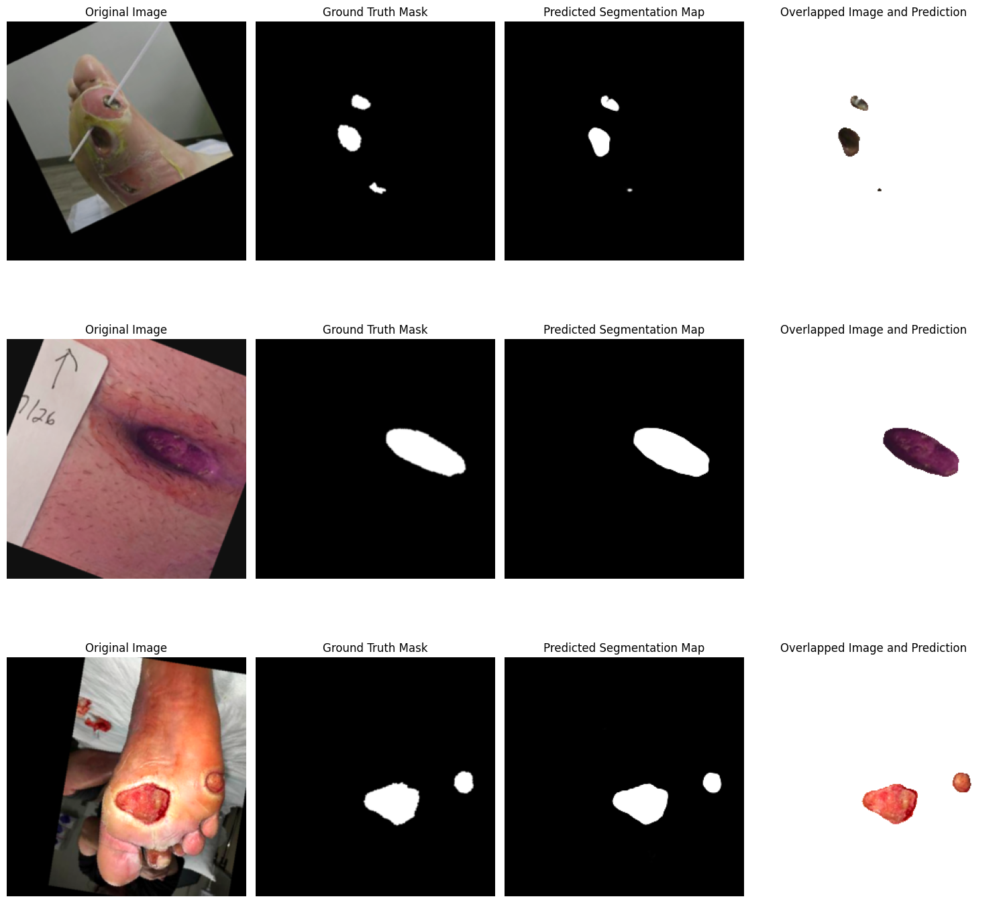

Epoch 32/100, Training Loss: 0.1022, Validation Loss: 0.0094, Validation Dice: 0.9220,Validation IOU: 0.7912


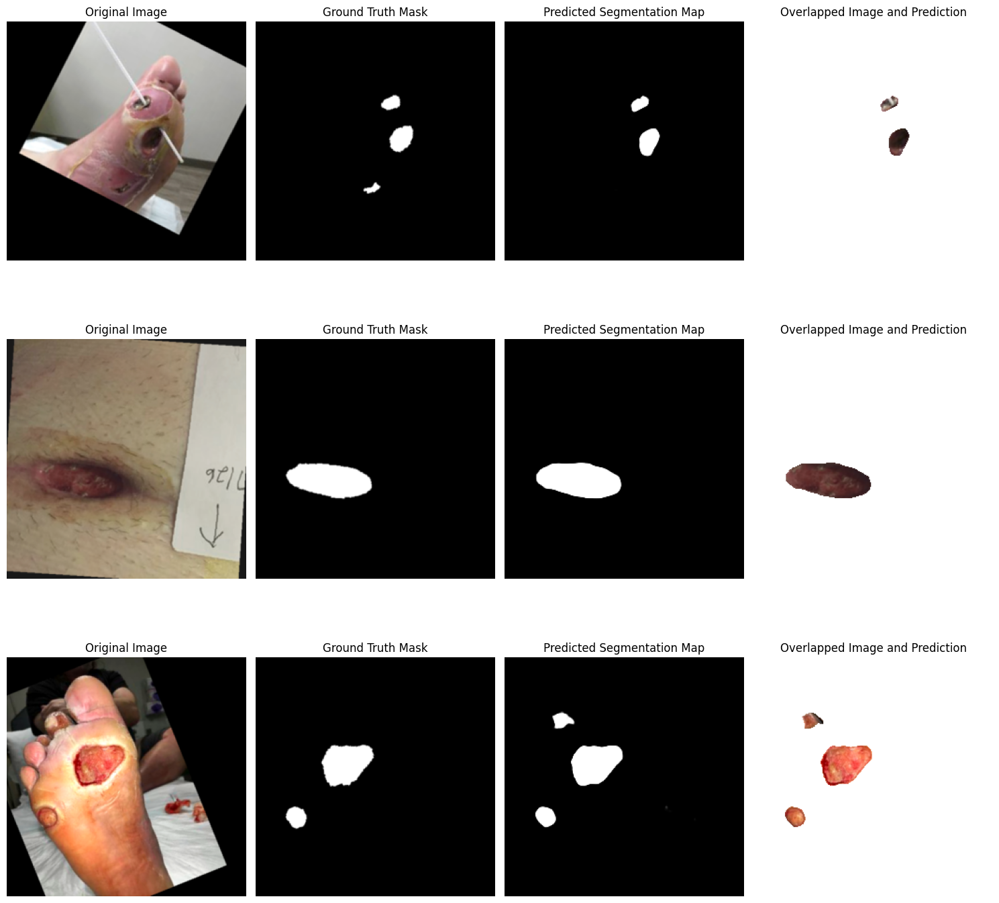

Validation loss decreased (0.008902 --> 0.008887).  Saving model ...
Epoch 33/100, Training Loss: 0.0964, Validation Loss: 0.0089, Validation Dice: 0.9278,Validation IOU: 0.7978


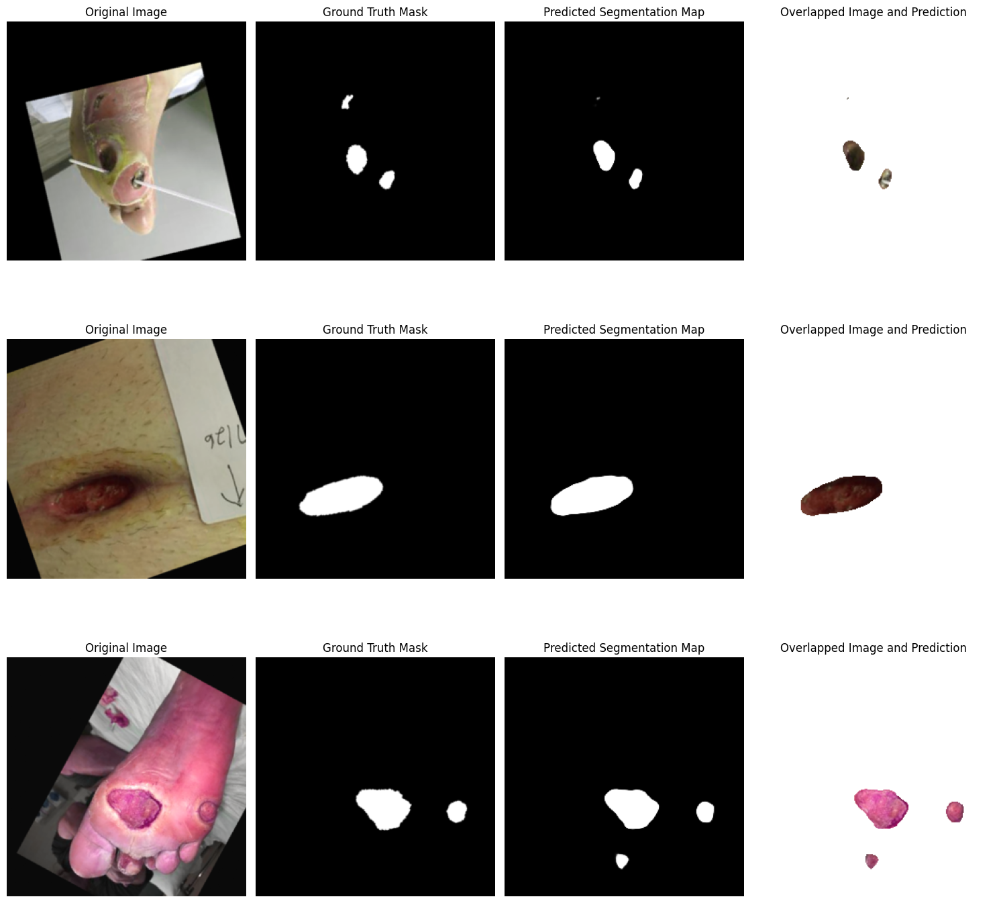

Epoch 34/100, Training Loss: 0.0953, Validation Loss: 0.0090, Validation Dice: 0.9257,Validation IOU: 0.7935


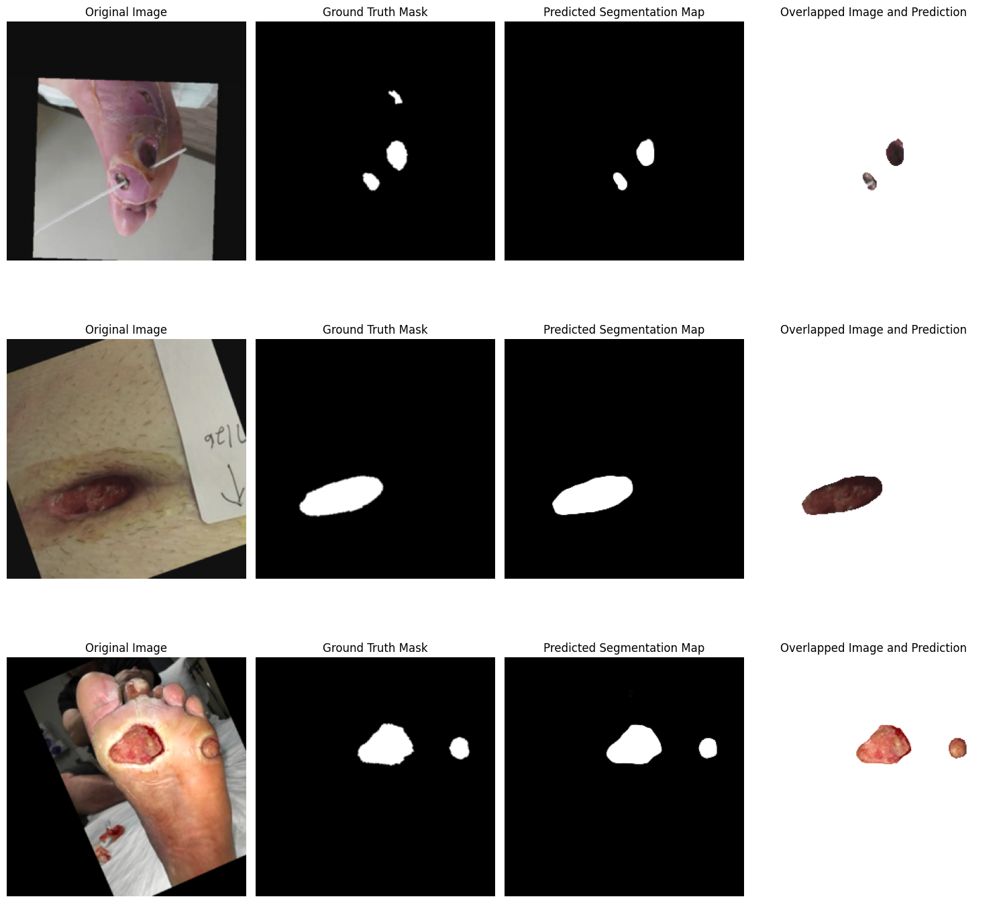

Epoch 35/100, Training Loss: 0.0945, Validation Loss: 0.0089, Validation Dice: 0.9271,Validation IOU: 0.7970


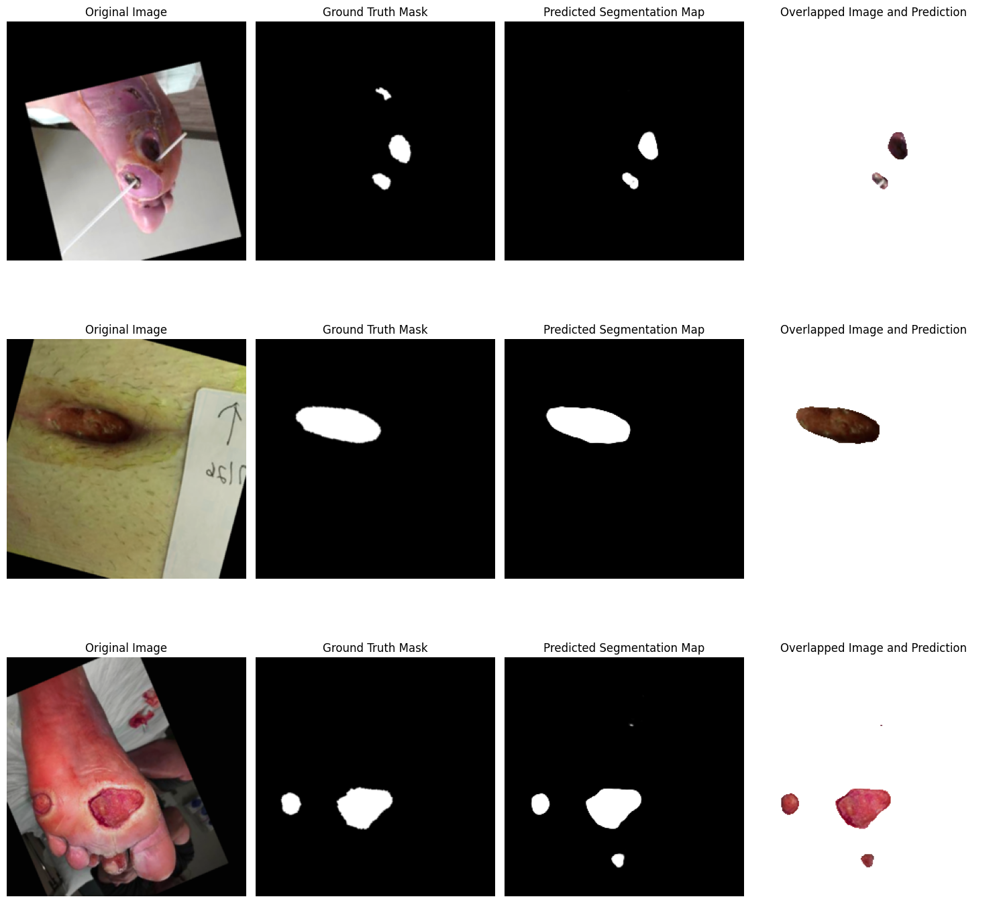

Epoch 36/100, Training Loss: 0.0930, Validation Loss: 0.0091, Validation Dice: 0.9250,Validation IOU: 0.8003


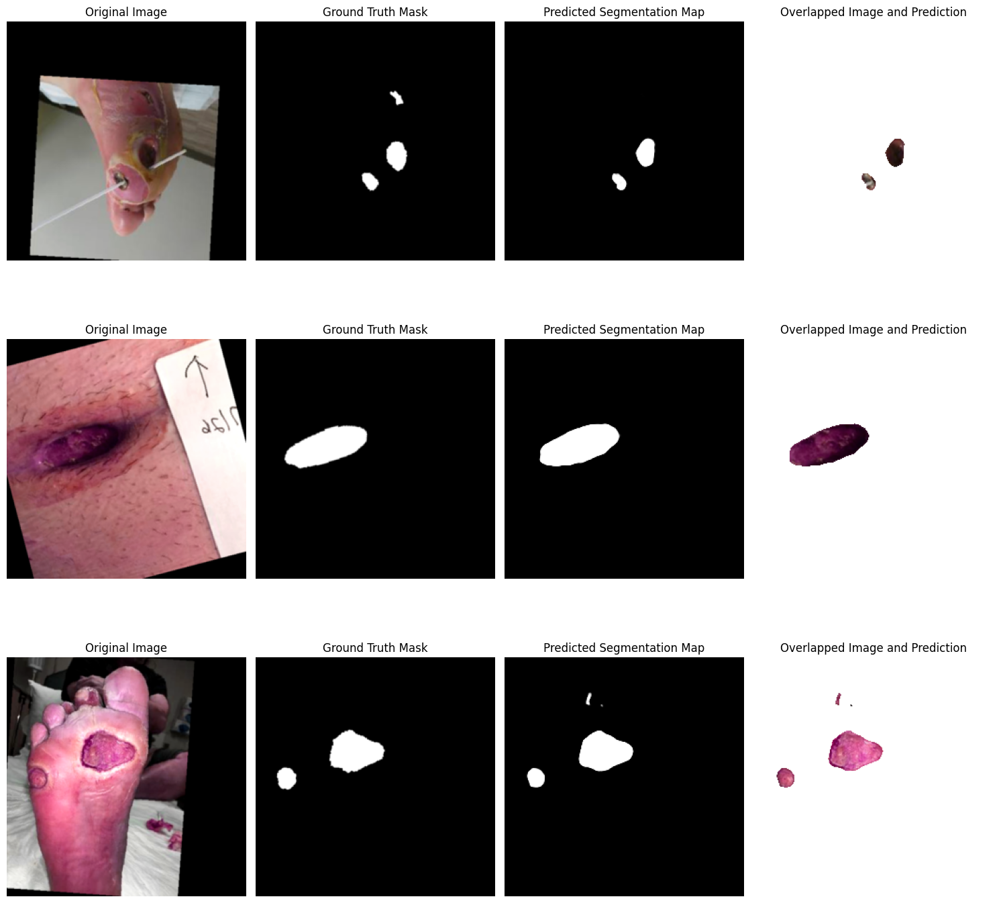

Epoch 37/100, Training Loss: 0.0926, Validation Loss: 0.0093, Validation Dice: 0.9231,Validation IOU: 0.7918


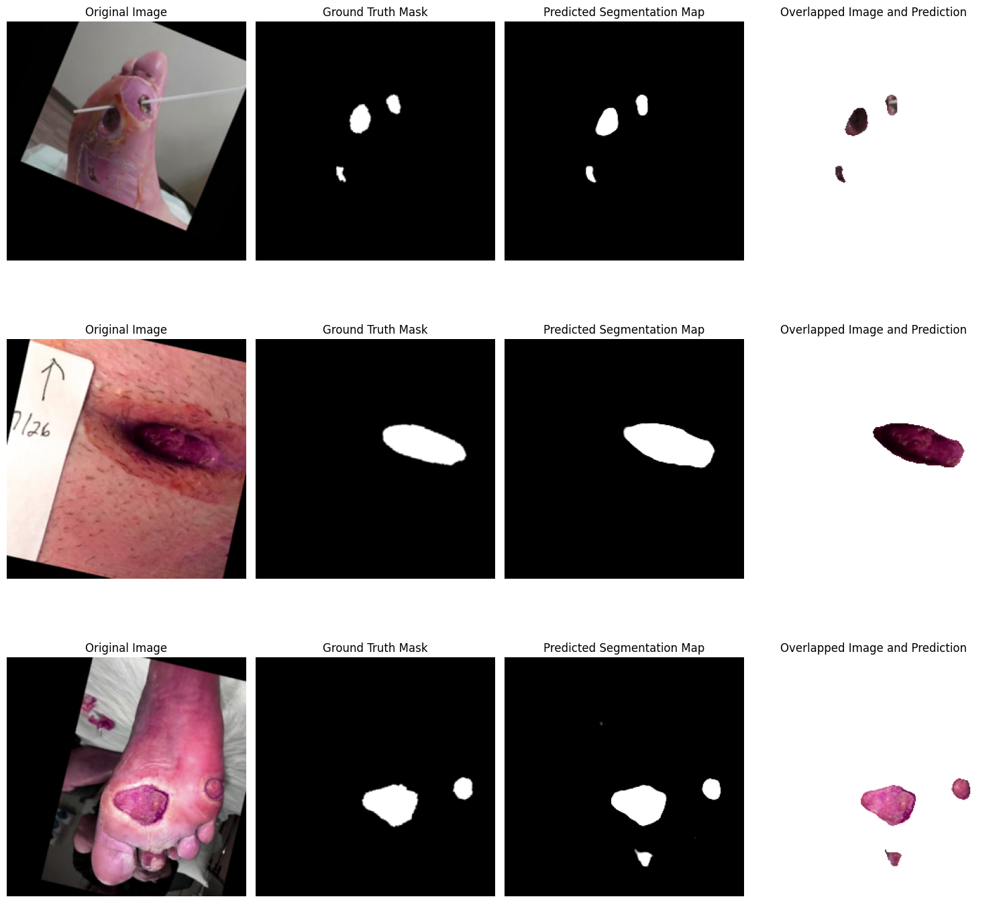

Validation loss decreased (0.008887 --> 0.008834).  Saving model ...
Epoch 38/100, Training Loss: 0.0944, Validation Loss: 0.0088, Validation Dice: 0.9270,Validation IOU: 0.8036


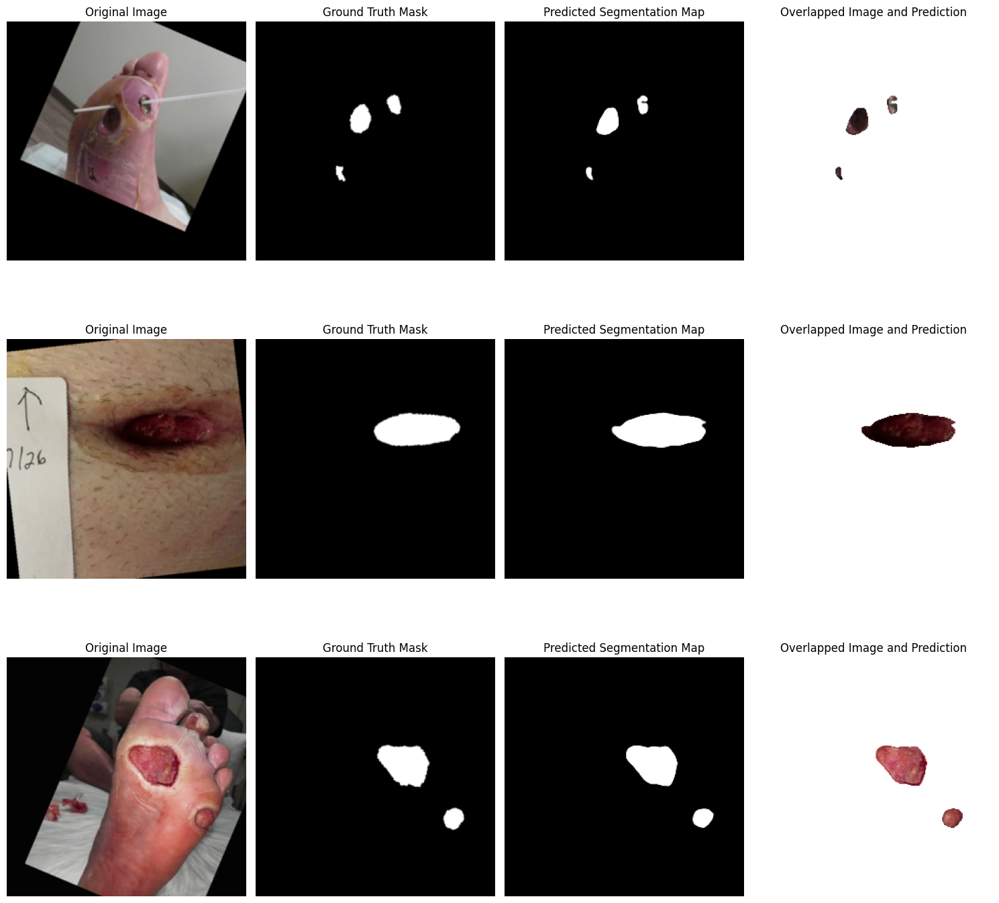

Epoch 39/100, Training Loss: 0.0907, Validation Loss: 0.0089, Validation Dice: 0.9274,Validation IOU: 0.7893


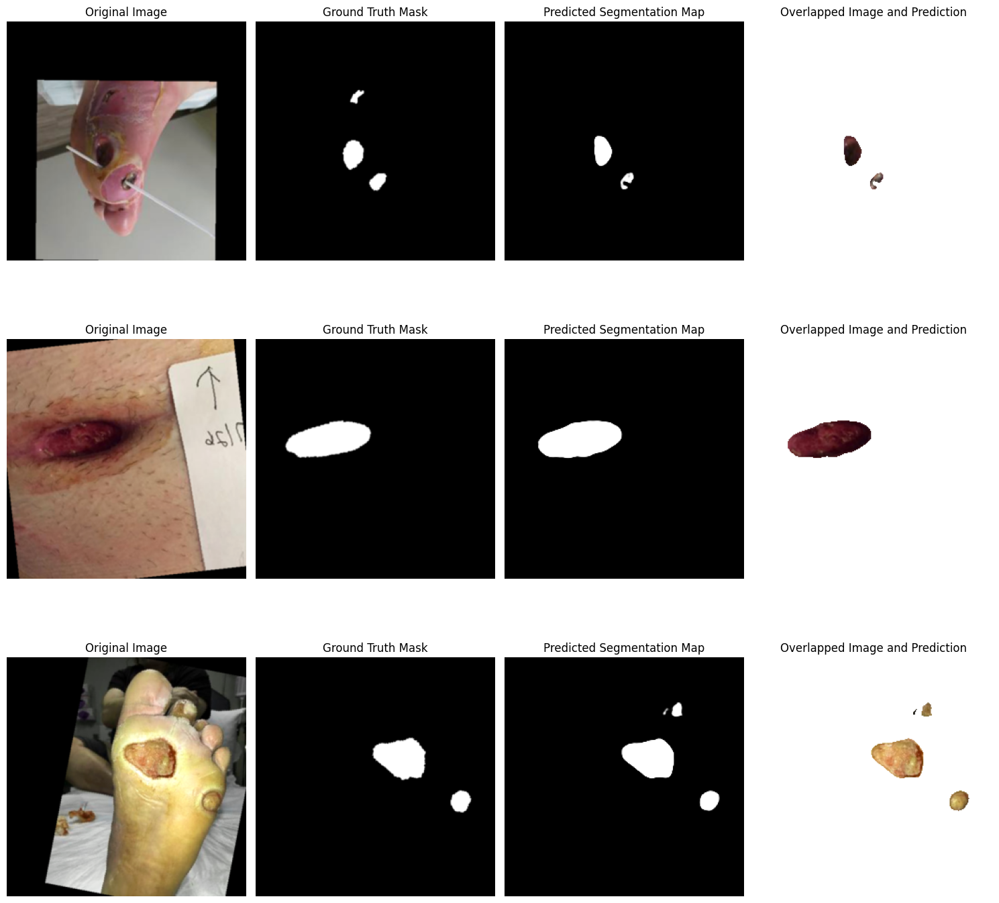

Validation loss decreased (0.008834 --> 0.008663).  Saving model ...
Epoch 40/100, Training Loss: 0.0938, Validation Loss: 0.0087, Validation Dice: 0.9287,Validation IOU: 0.8027


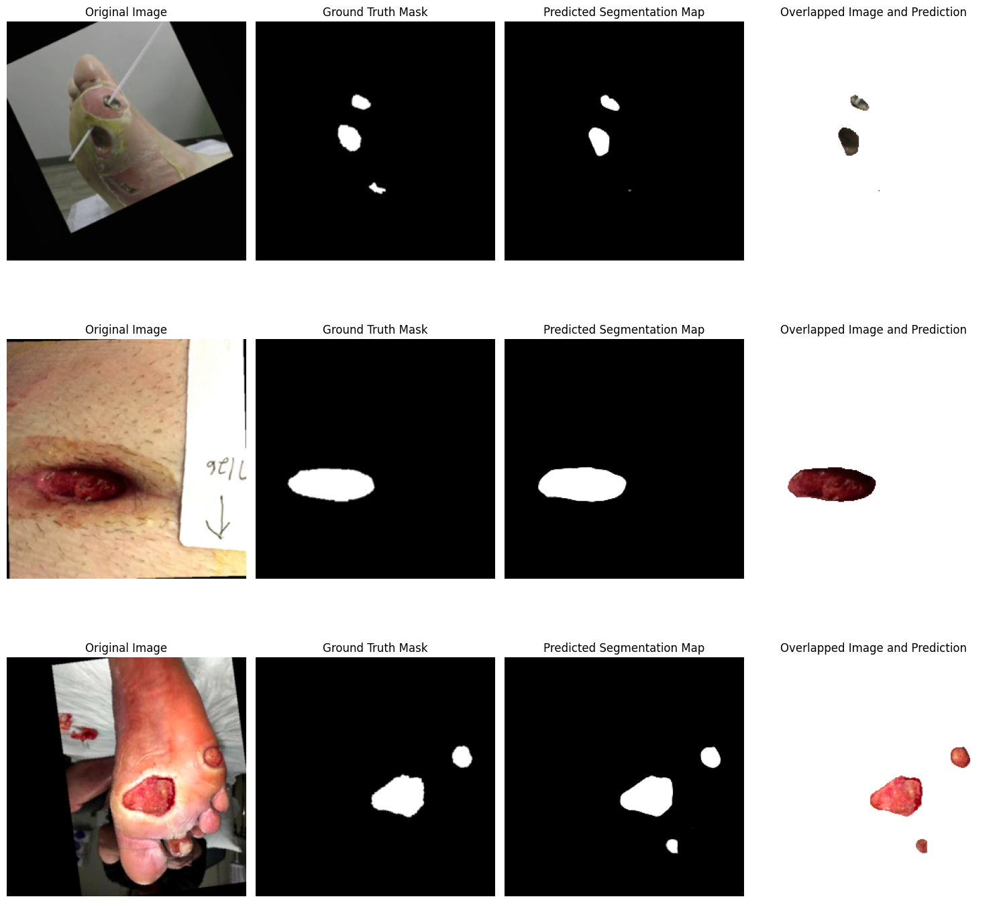

Validation loss decreased (0.008663 --> 0.008639).  Saving model ...
Epoch 41/100, Training Loss: 0.0923, Validation Loss: 0.0086, Validation Dice: 0.9287,Validation IOU: 0.7960


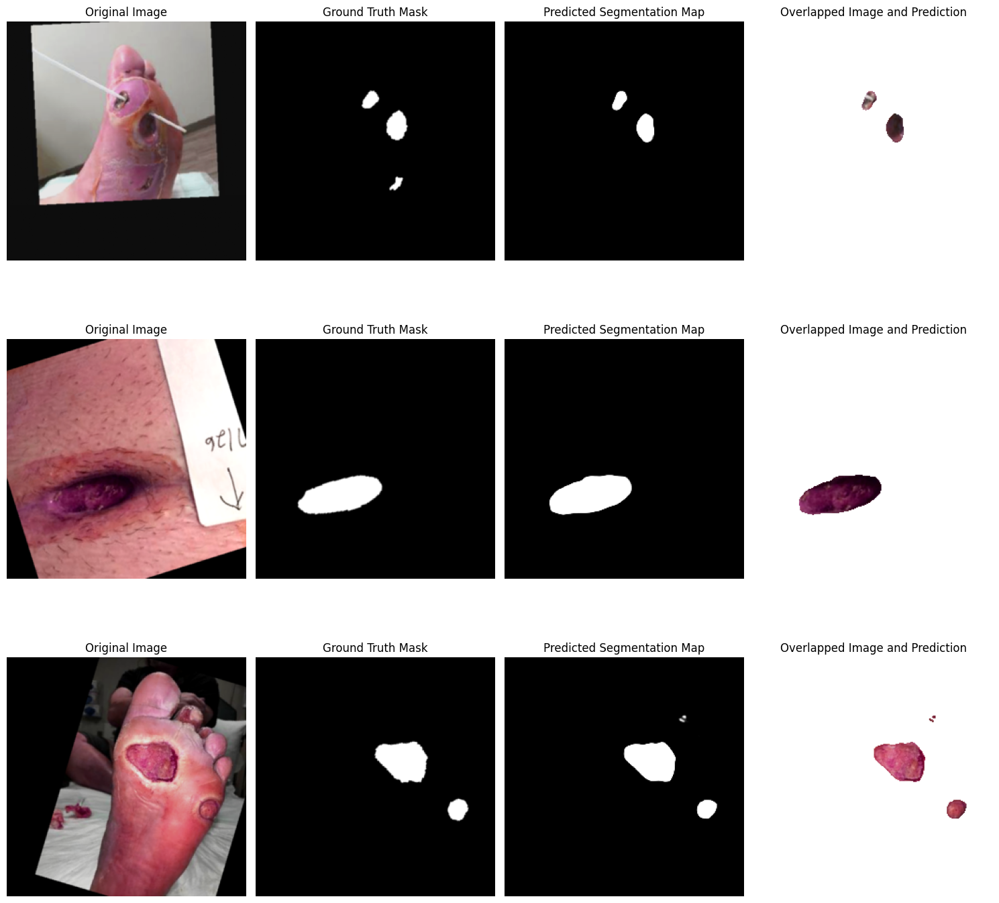

Epoch 42/100, Training Loss: 0.0919, Validation Loss: 0.0091, Validation Dice: 0.9246,Validation IOU: 0.8000


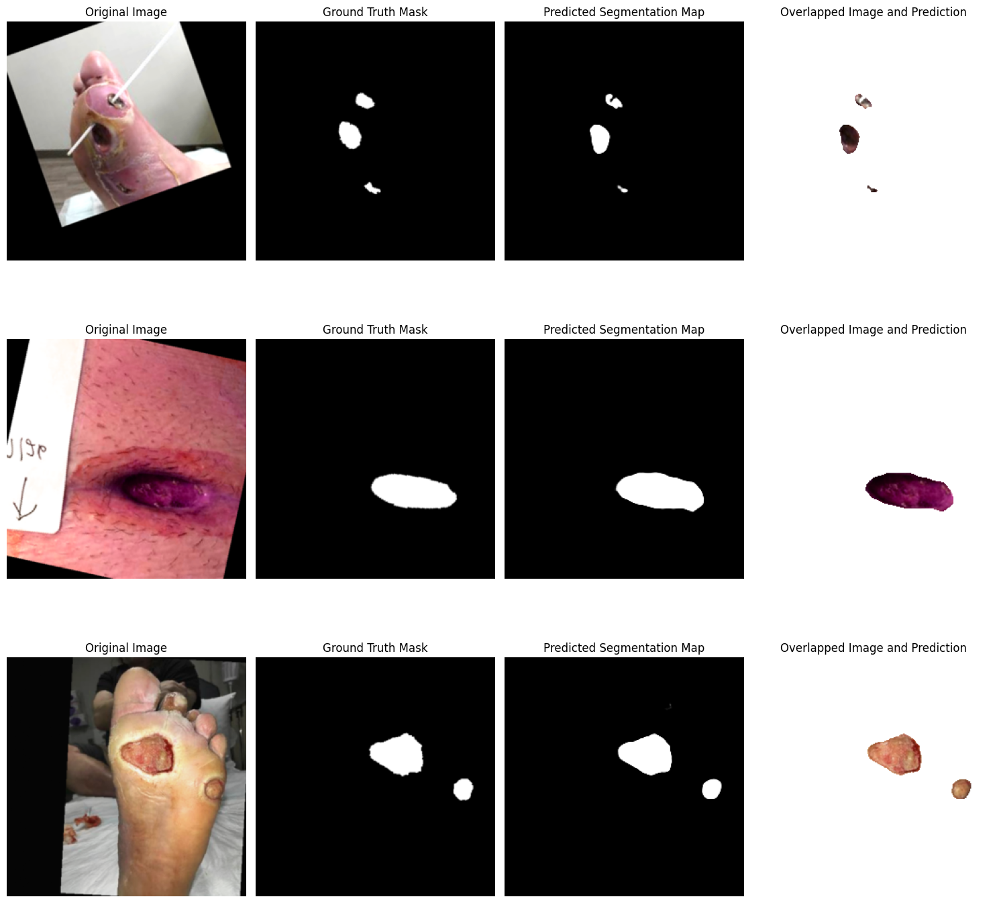

Validation loss decreased (0.008639 --> 0.008561).  Saving model ...
Epoch 43/100, Training Loss: 0.0900, Validation Loss: 0.0086, Validation Dice: 0.9291,Validation IOU: 0.8099


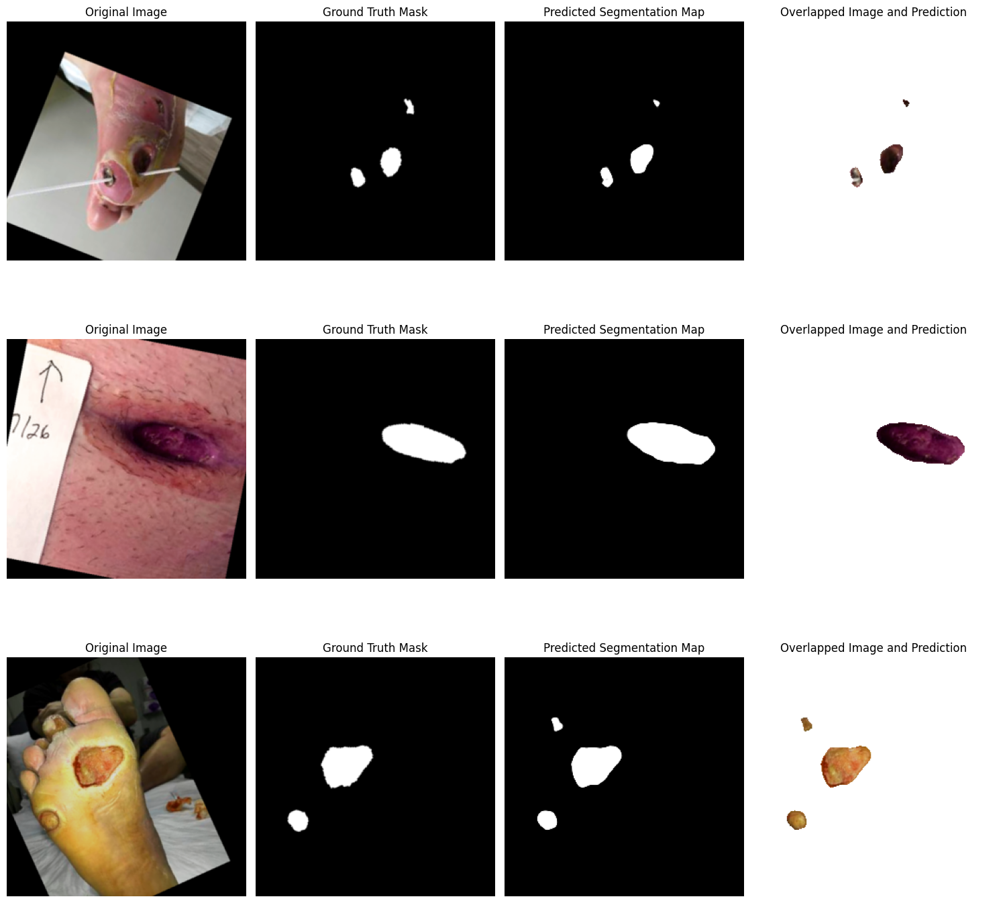

Validation loss decreased (0.008561 --> 0.008450).  Saving model ...
Epoch 44/100, Training Loss: 0.0922, Validation Loss: 0.0084, Validation Dice: 0.9301,Validation IOU: 0.8064


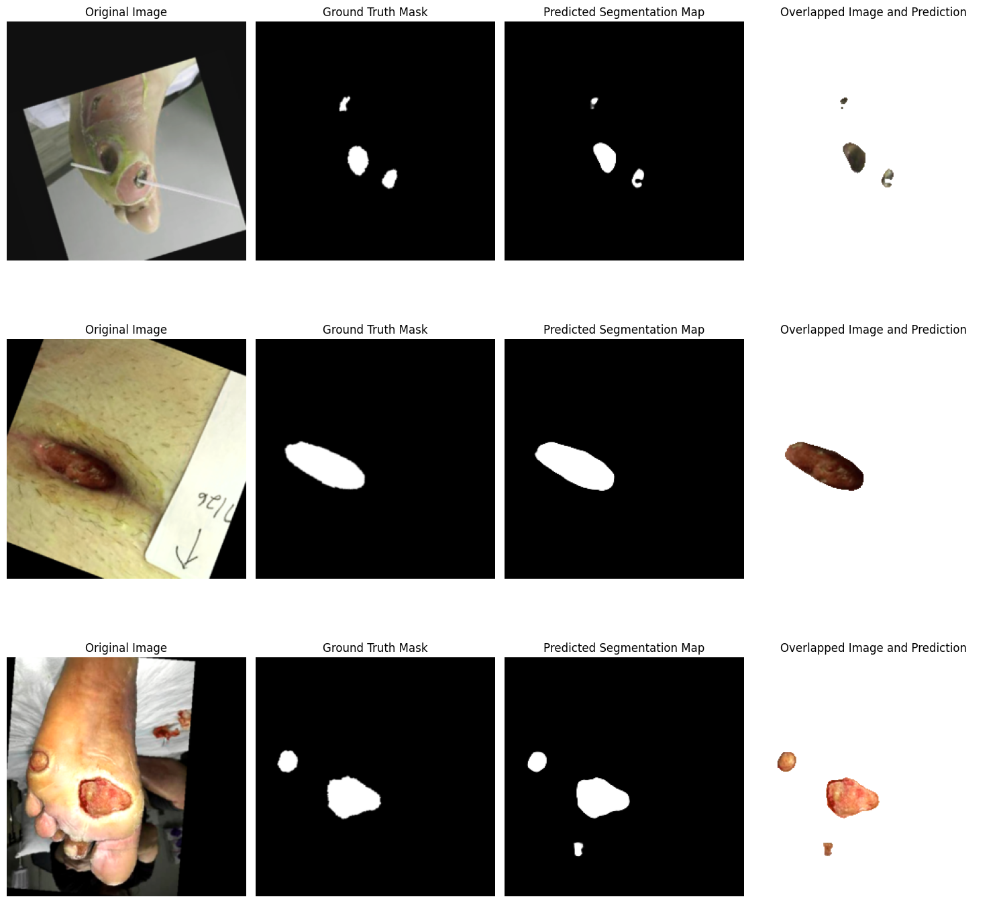

Epoch 45/100, Training Loss: 0.0893, Validation Loss: 0.0086, Validation Dice: 0.9284,Validation IOU: 0.8062


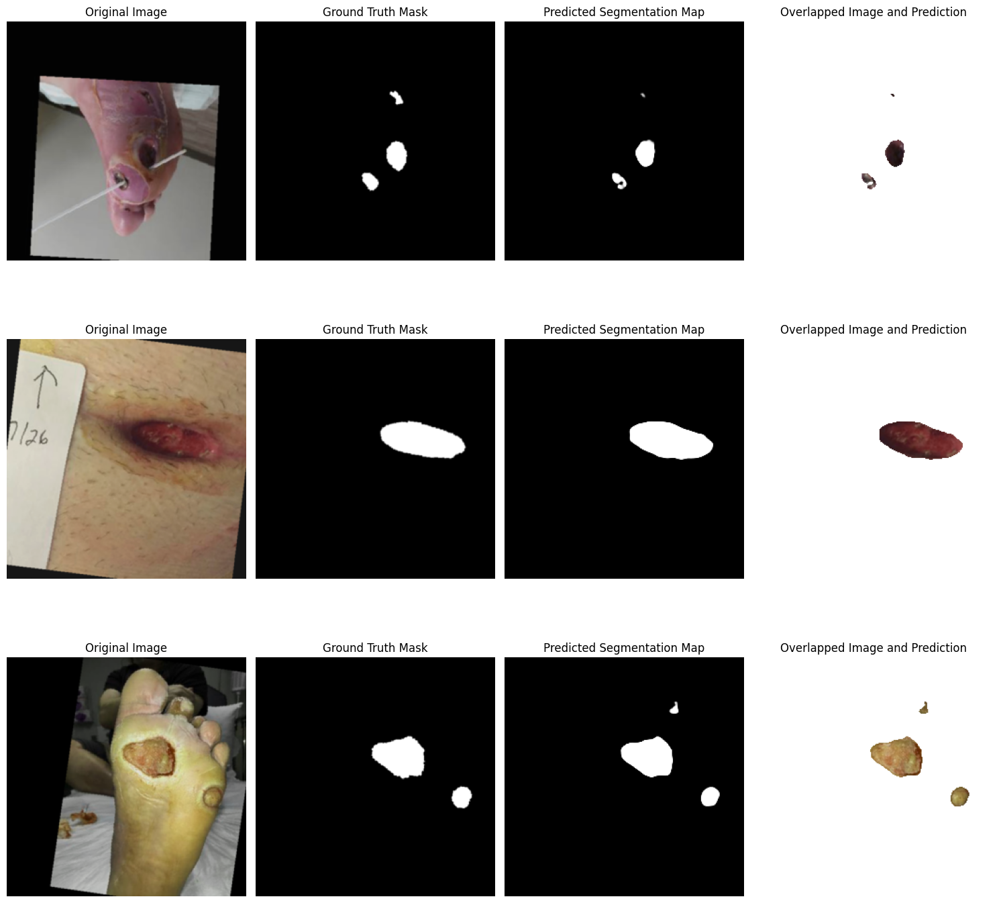

Epoch 46/100, Training Loss: 0.0915, Validation Loss: 0.0088, Validation Dice: 0.9260,Validation IOU: 0.7986


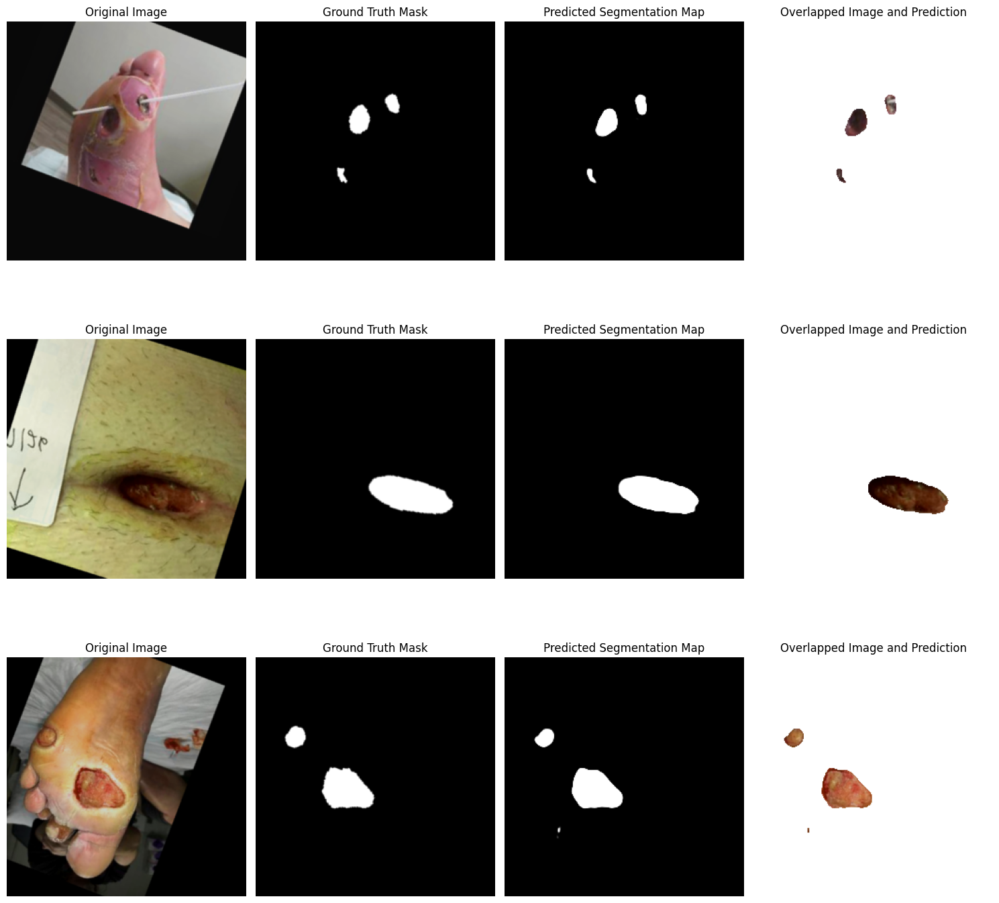

Epoch 47/100, Training Loss: 0.0899, Validation Loss: 0.0086, Validation Dice: 0.9276,Validation IOU: 0.7949


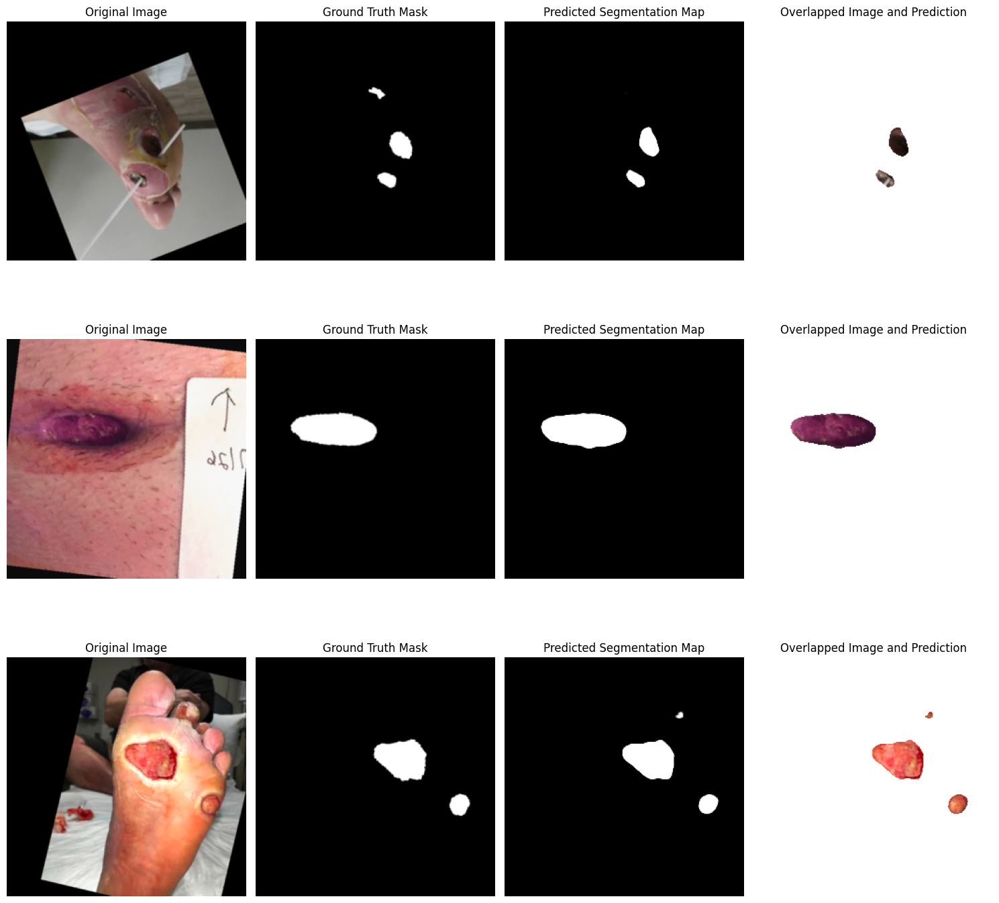

Validation loss decreased (0.008450 --> 0.008395).  Saving model ...
Epoch 48/100, Training Loss: 0.0857, Validation Loss: 0.0084, Validation Dice: 0.9298,Validation IOU: 0.8116


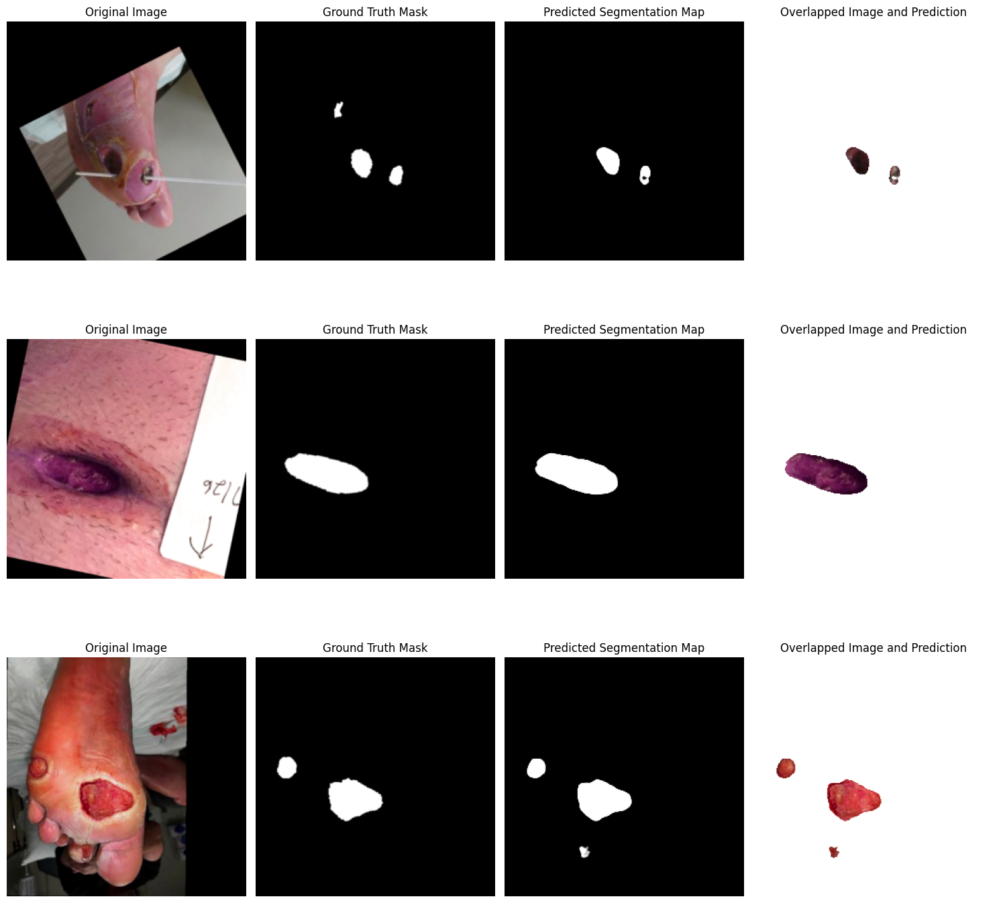

Epoch 49/100, Training Loss: 0.0869, Validation Loss: 0.0088, Validation Dice: 0.9270,Validation IOU: 0.7979


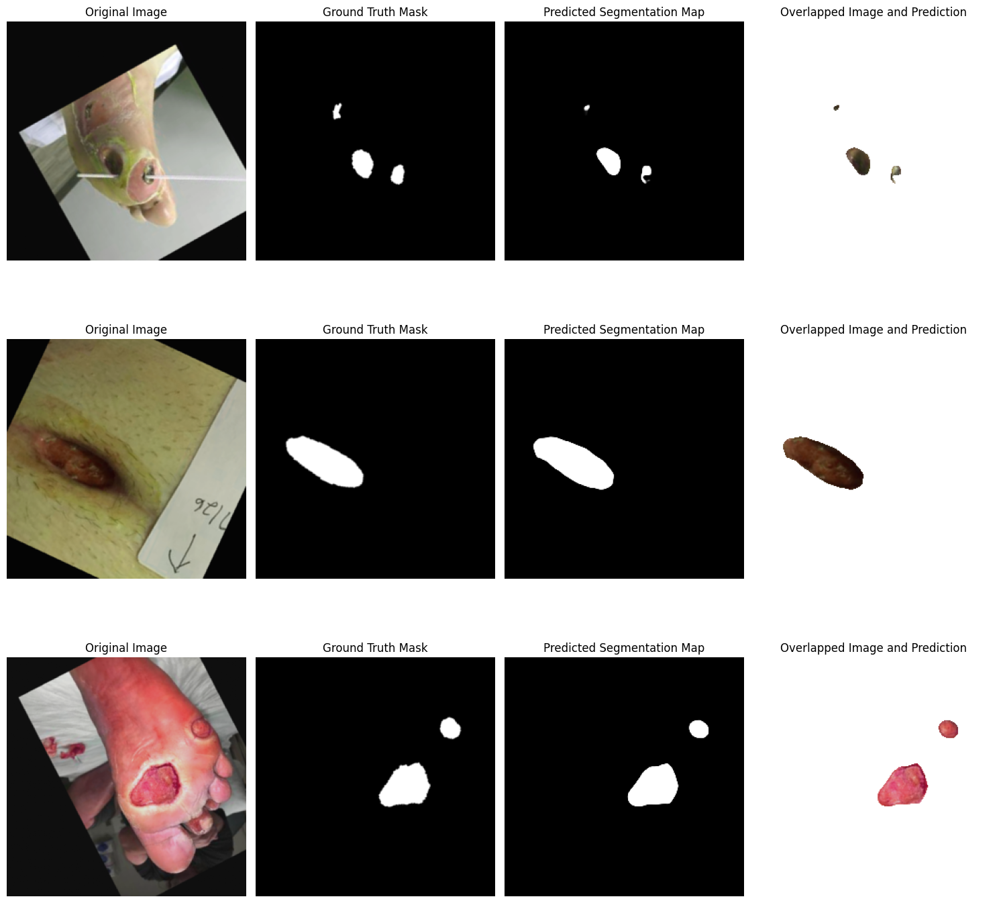

Epoch 50/100, Training Loss: 0.0852, Validation Loss: 0.0085, Validation Dice: 0.9295,Validation IOU: 0.8052


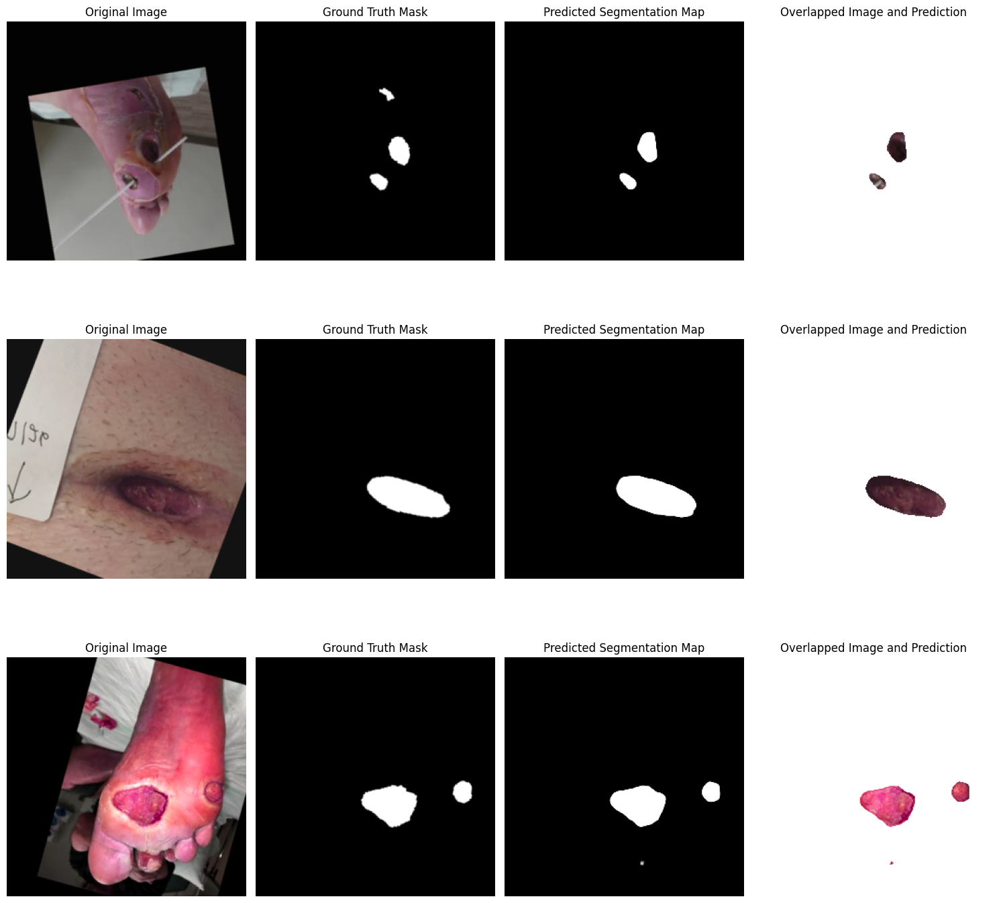

Epoch 51/100, Training Loss: 0.0835, Validation Loss: 0.0085, Validation Dice: 0.9299,Validation IOU: 0.8073


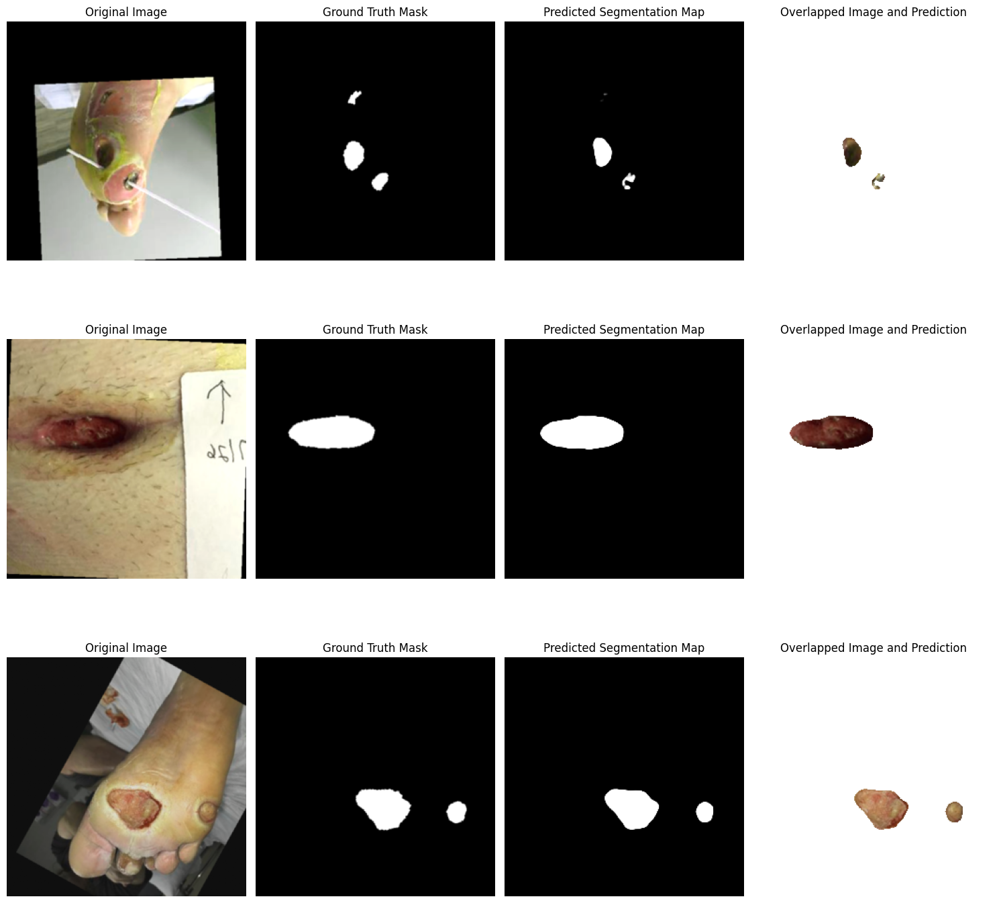

Validation loss decreased (0.008395 --> 0.008269).  Saving model ...
Epoch 52/100, Training Loss: 0.0823, Validation Loss: 0.0083, Validation Dice: 0.9315,Validation IOU: 0.8034


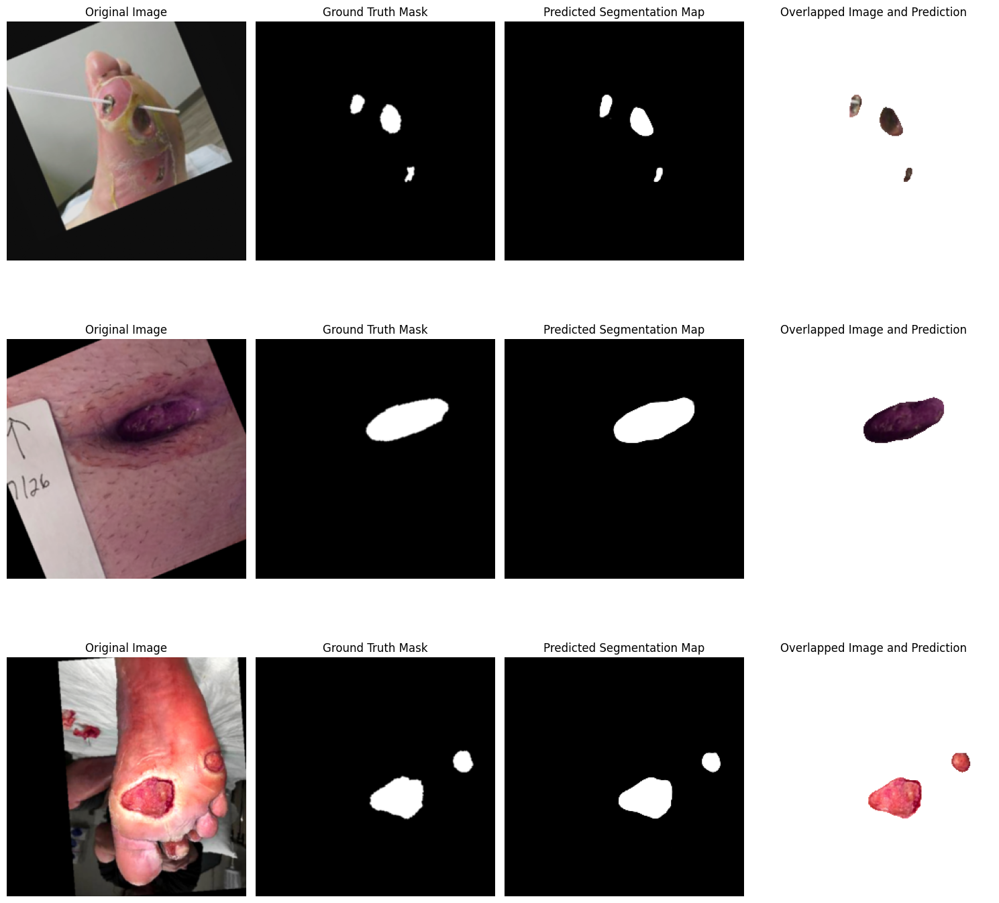

Epoch 53/100, Training Loss: 0.0822, Validation Loss: 0.0083, Validation Dice: 0.9307,Validation IOU: 0.8072


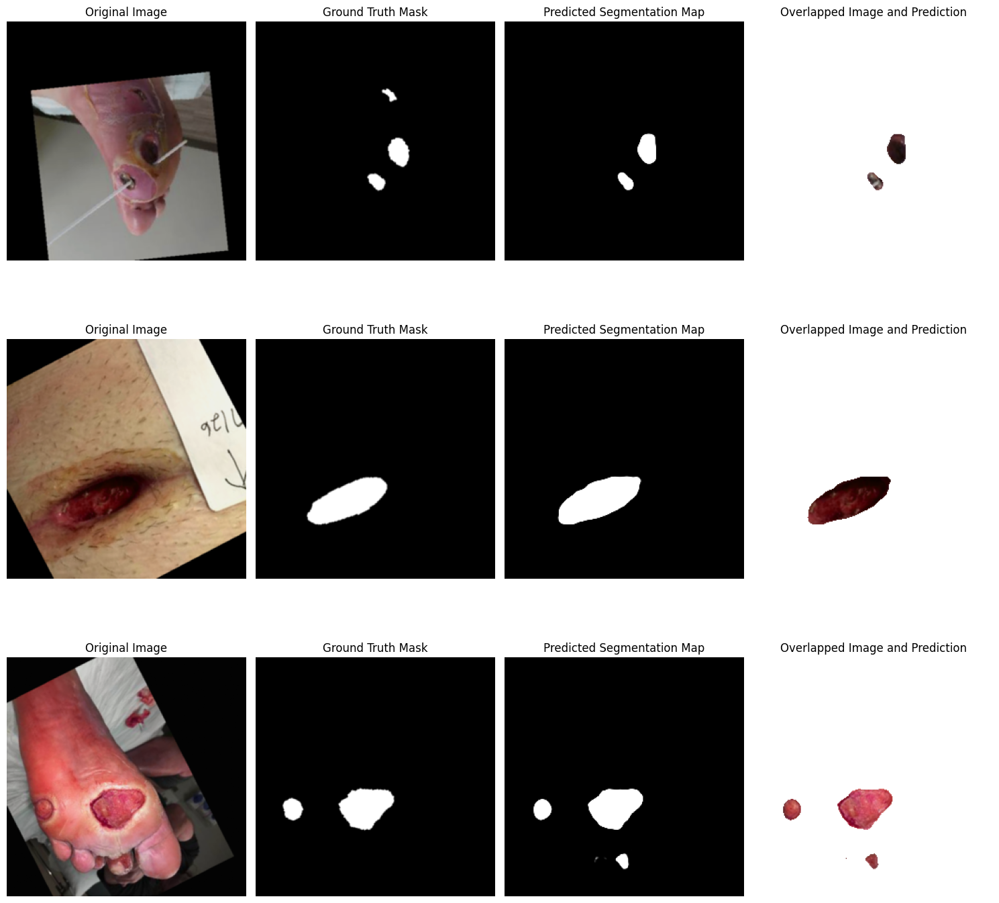

Epoch 54/100, Training Loss: 0.0828, Validation Loss: 0.0086, Validation Dice: 0.9291,Validation IOU: 0.8101


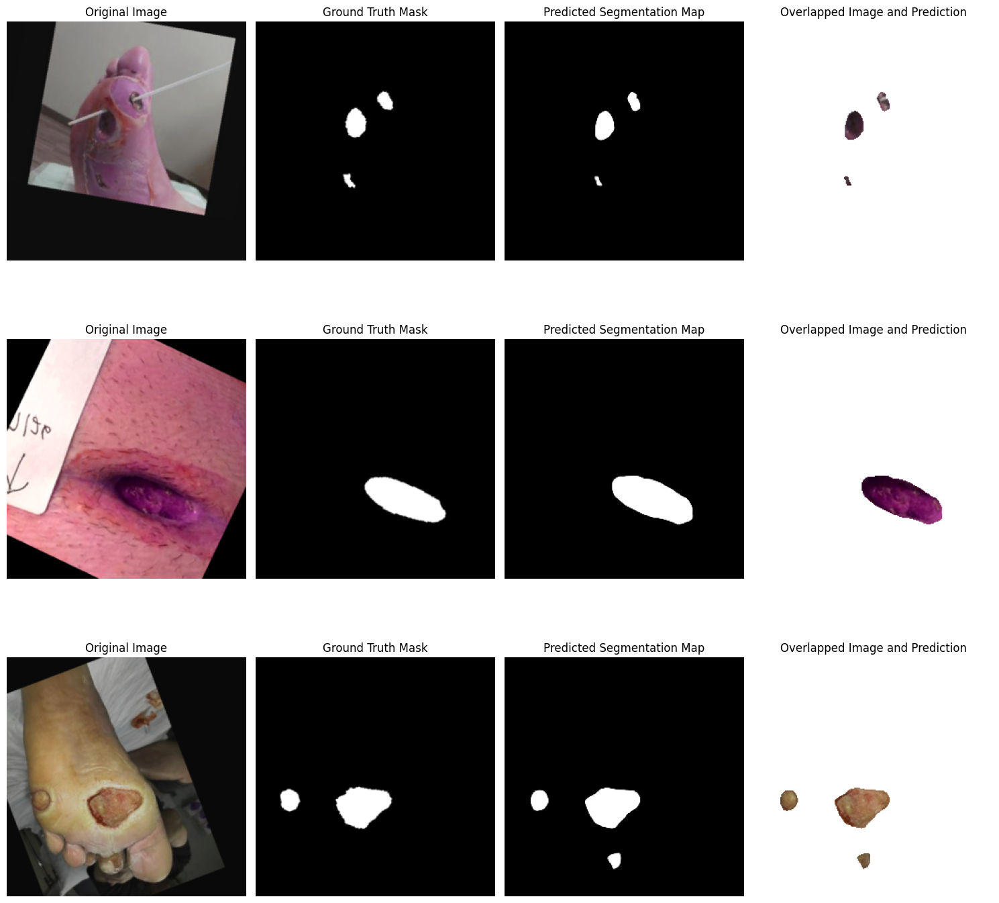

Epoch 55/100, Training Loss: 0.0805, Validation Loss: 0.0084, Validation Dice: 0.9296,Validation IOU: 0.8053


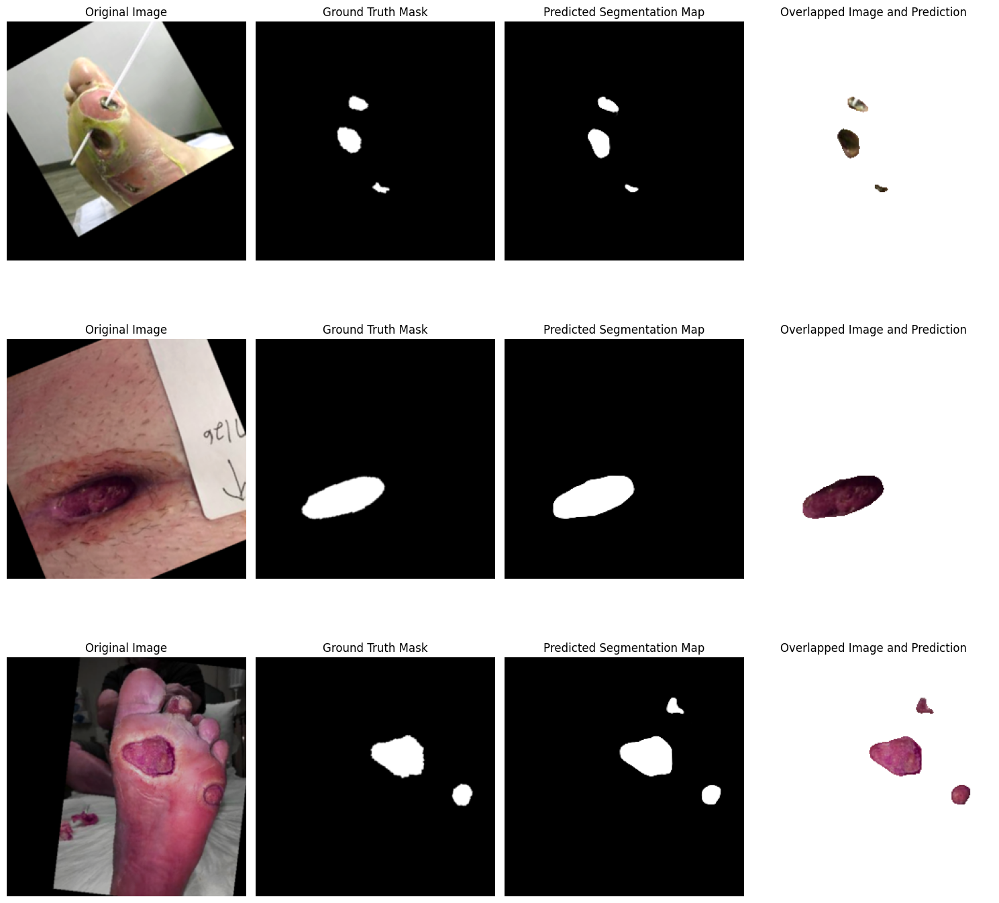

Epoch 56/100, Training Loss: 0.0812, Validation Loss: 0.0085, Validation Dice: 0.9295,Validation IOU: 0.8173


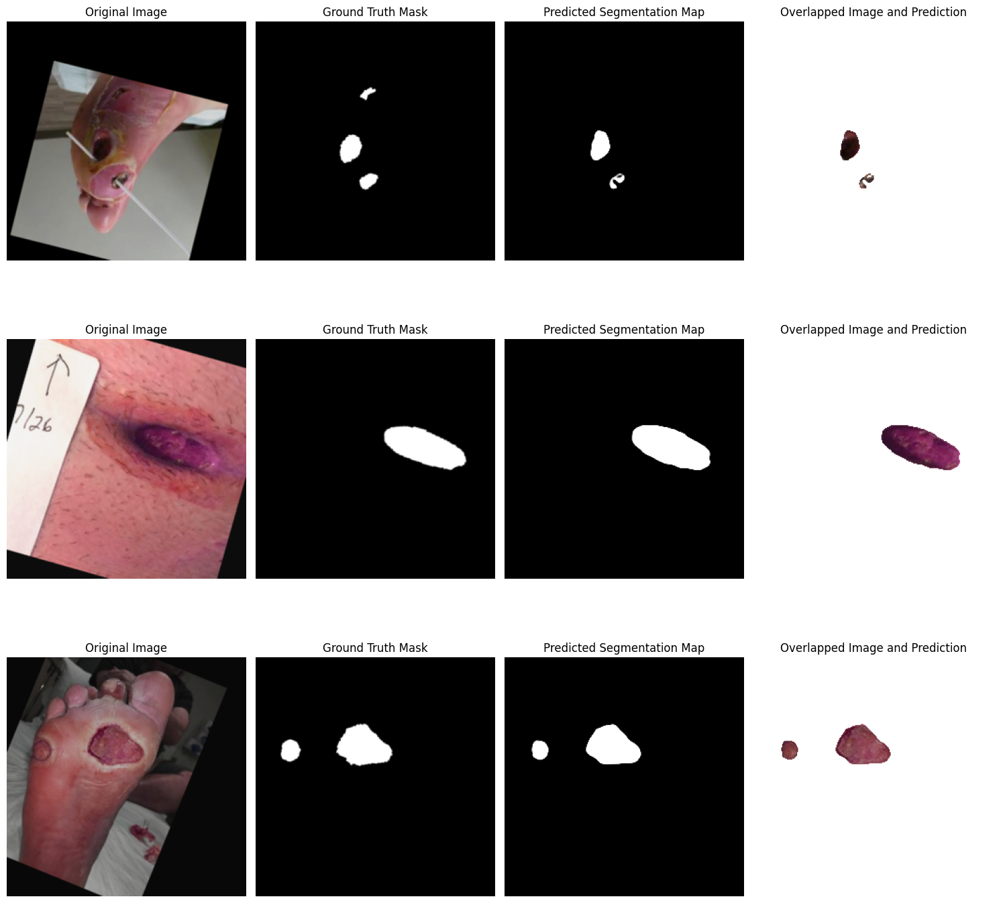

Epoch 57/100, Training Loss: 0.0802, Validation Loss: 0.0089, Validation Dice: 0.9250,Validation IOU: 0.7975


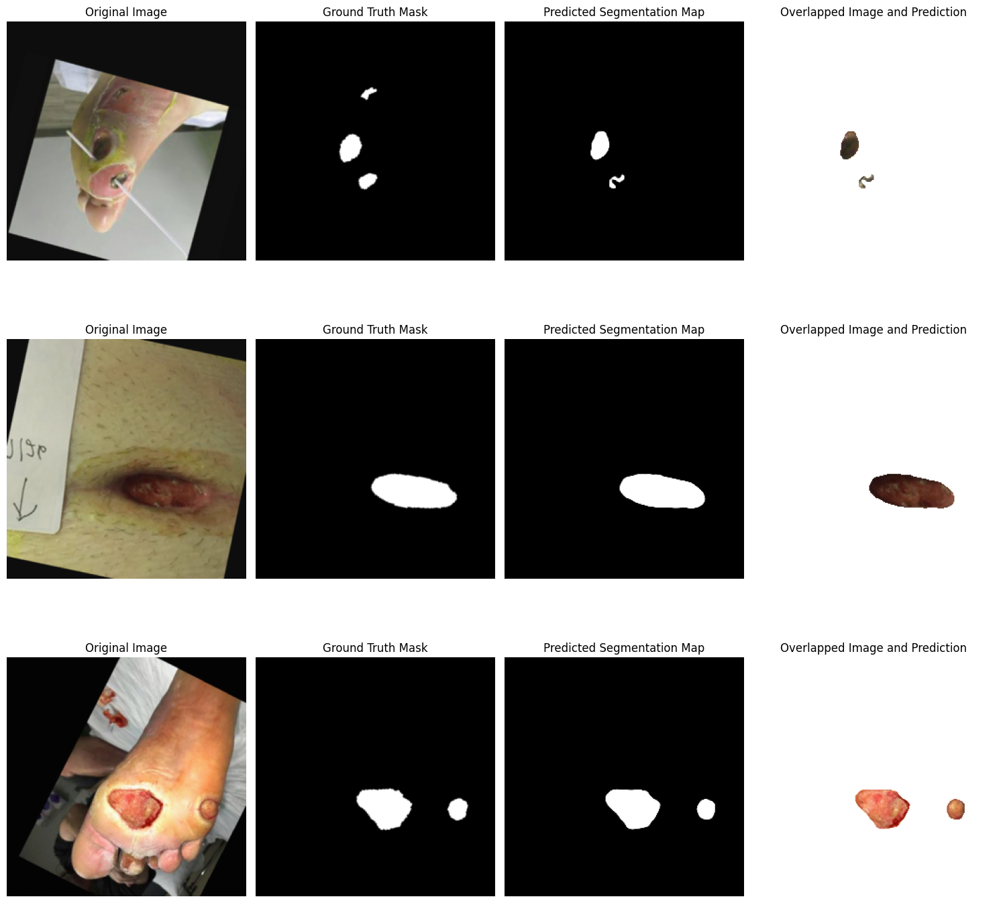

Epoch 58/100, Training Loss: 0.0823, Validation Loss: 0.0088, Validation Dice: 0.9269,Validation IOU: 0.8028


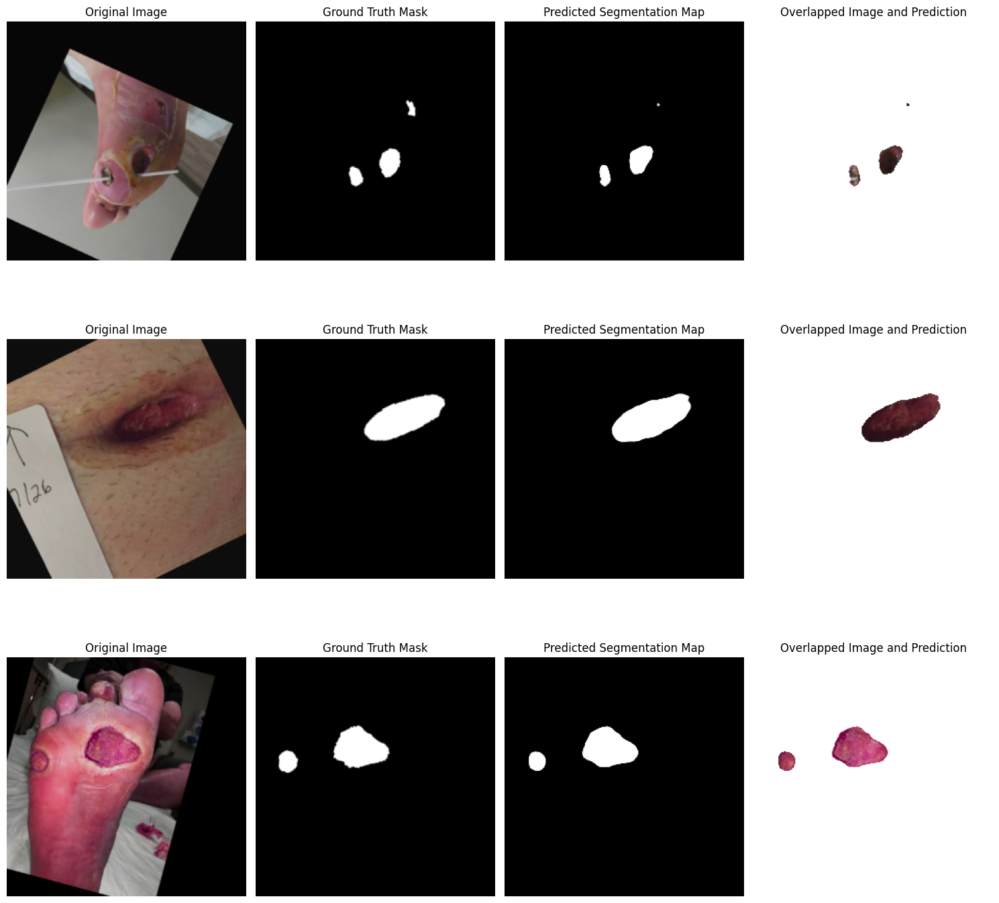

Epoch 59/100, Training Loss: 0.0803, Validation Loss: 0.0087, Validation Dice: 0.9271,Validation IOU: 0.8088


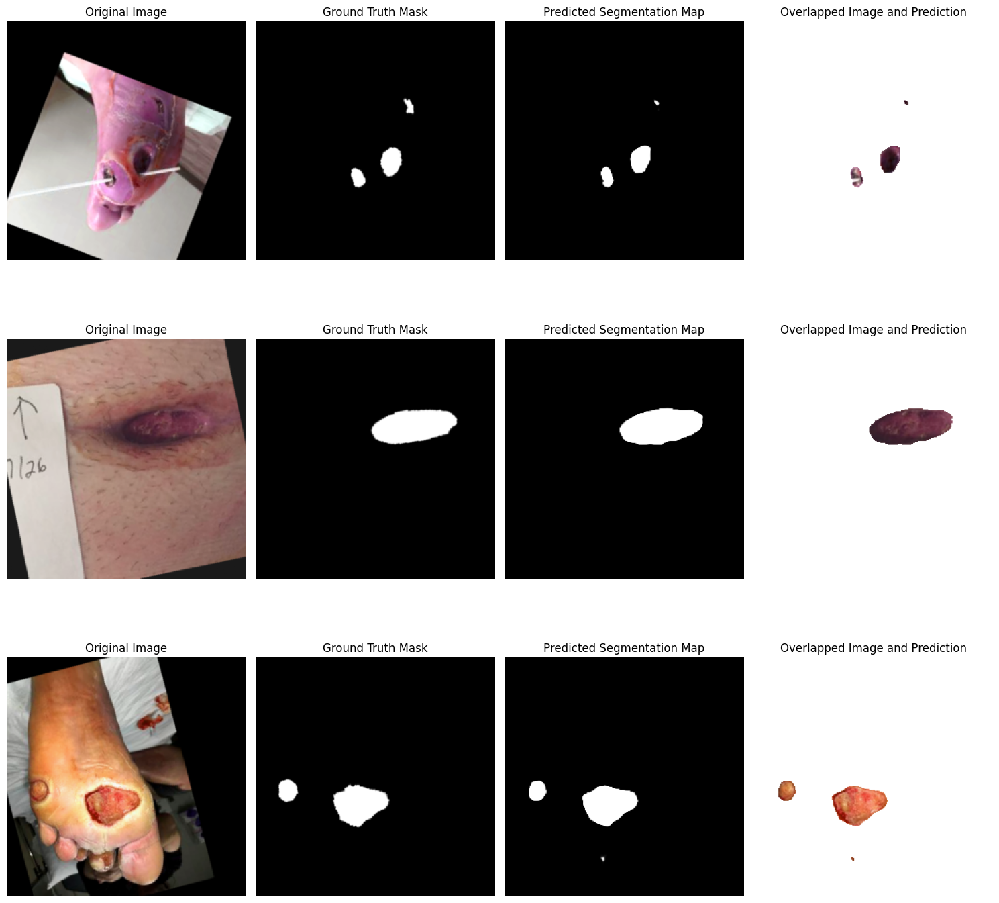

Epoch 60/100, Training Loss: 0.0802, Validation Loss: 0.0086, Validation Dice: 0.9274,Validation IOU: 0.8084


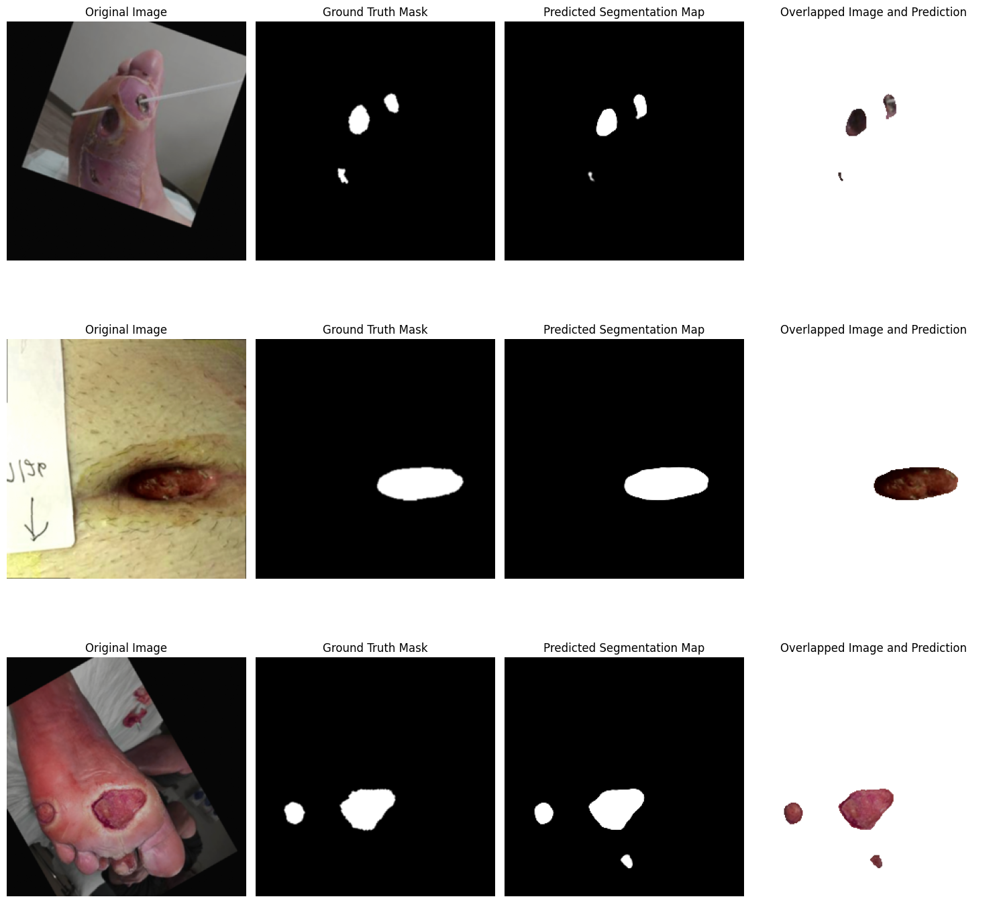

Epoch 61/100, Training Loss: 0.0778, Validation Loss: 0.0085, Validation Dice: 0.9290,Validation IOU: 0.8095


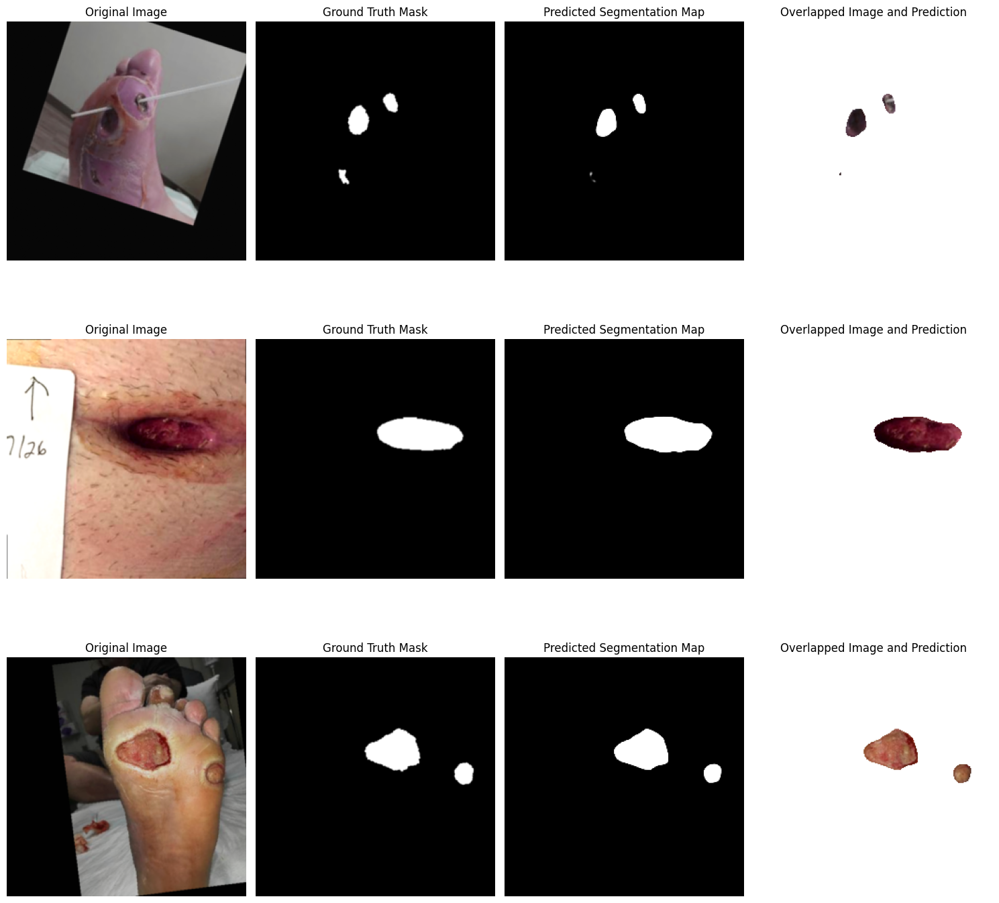

Early stopping
Epoch 62/100, Training Loss: 0.0780, Validation Loss: 0.0089, Validation Dice: 0.9249,Validation IOU: 0.8066


In [12]:
from segmentation_models_pytorch.losses import JaccardLoss, DiceLoss, FocalLoss, LovaszLoss, SoftBCEWithLogitsLoss, SoftCrossEntropyLoss

lr = 5.65751682018103e-05
weight_decay = 8.05107140861181e-05
dropout_rate = 0.319067916776741

#lr = .001
#weight_decay = 0.0001
#dropout_rate = 0.319067916776741
#loss_function = loss_function = DiceLoss(mode ="binary"
                             #from_logits =,
                             #smooth =1e-6
                             #log_loss = ,
                             #ignore_index =,
                             #eps =,
                            #)
loss_function = myCombinedDiceFocalBCE()
encoder_name = "efficientnet-b7"
batch_size = 16
print(f"LossFunction: {loss_function}")
print(f"Encoder: {encoder_name}")
print(f"Batch Size: {batch_size}")
print(f"Learning Rate: {lr}")
print(f"Weight Decay: {weight_decay}")
#print(f"Dropout Rate: {dropout_rate}")
#if loss_function_name == "FocalLoss":
    #print(f"Alpha: {alpha}")
    #print(f"Gamma: {gamma}")

# Create data loaders with the suggested batch size
train_loader, valid_loader = create_data_loaders(batch_size)

# Create a U-Net model_1 with the suggested dropout rate
model_1 = Unet(encoder_name = encoder_name,
             encoder_weights="imagenet",
             in_channels=3,
             classes=1,
             #decoder_attention_type = "scse",
             activation='sigmoid').cuda()

# Set dropout rate if applicable
#for module in model_1.modules():
 #   if isinstance(module, nn.Dropout):
  #      module.p = dropout_rate

#if loss_function_name == "FocalLoss":
 #   alpha = trial.suggest_uniform('alpha', 0.25,1 )
  #  gamma = trial.suggest_uniform('gamma', 1,5 )
   # criterion = FocalLoss(alpha=alpha, gamma=gamma)
   # print(alpha)
    #print(gamma)
#else:
 #   alpha = None
  #  gamma = None
    #criterion = loss_function_mapping[loss_function_name]()

criterion = loss_function
optimizer = optim.Adam(model_1.parameters(),lr=lr, weight_decay=weight_decay)
#scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.1, patience=5, verbose=True)

# Instantiate EarlyStopping with min_delta
early_stopping = EarlyStopping(patience=10, verbose=True)
best_val_dice = 0
num_epochs = 100
my_bool = bool(False)

for epoch in range(num_epochs):
    try:
        poly_lr_scheduler(optimizer, epoch, num_epochs, initial_lr=lr)
        train_loss = train_one_epoch(model_1, criterion, optimizer, train_loader,scaler)
        val_loss,val_dice,val_IOU = validate_one_epoch(model_1, criterion, valid_loader)
    except RuntimeError as e:
        if 'out of memory' in str(e):
            print(f"Out of memory at epoch {epoch}, reducing batch size and retrying...")
            del train_loader
            del valid_loader
            torch.cuda.empty_cache()
            batch_size = max(batch_size // 2, 1)
            train_loader, valid_loader = create_data_loaders(batch_size)
            continue
        else:
            raise e

    #scheduler.step(val_loss)
    early_stopping(val_loss, model_1)

    if early_stopping.early_stop:

        my_bool = bool(True)
        
        print("Early stopping")
        
        print(f"Epoch {epoch+1}/{num_epochs}, Training Loss: {train_loss:.4f}, Validation Loss: {val_loss:.4f}, Validation Dice: {val_dice:.4f},Validation IOU: {val_IOU:.4f}")
        
        break
    if val_dice > best_val_dice:
        best_val_dice = val_dice
    print(f"Epoch {epoch+1}/{num_epochs}, Training Loss: {train_loss:.4f}, Validation Loss: {val_loss:.4f}, Validation Dice: {val_dice:.4f},Validation IOU: {val_IOU:.4f}")

torch.save(model_1.state_dict(), '/home/exx/Deep_learning/Daniel_Doyon/Saved Models/model1.pth')
del model_1
torch.cuda.empty_cache()